In [2]:
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import utils
import seaborn as sns
import importlib
from tqdm import tqdm
from joblib import Parallel, delayed
import multiprocessing as mp
import warping
import matplotlib.cm as cm

path_figs = "./Figs/"

path = "./SL3/SL3"

path_misc = "./SL3_miscs/"

fingers = [0, 1, 2, 3, 4]

iti = 500

total_sub_num = 16

n_samples = 300
n_samples_left_right = 30


In [3]:
importlib.reload(utils)

<module 'utils' from '/Users/amin/projects/SequenceLearningAtsushi/utils.py'>

In [4]:
subjs = pd.read_csv(path_misc + "subjs.csv")

In [5]:
# subjs = utils.remove_error_trials(subjs)

In [6]:
rank_df = pd.DataFrame(index = subjs.index, dtype='int')
for subnum, data in subjs.groupby('SubNum'):
    data = data.sort_values(by = ['BN', 'TN'])
    data['N'] = data.groupby(['BN', 'TN']).ngroup() + 1
    rank_df.loc[data.index, 'N'] = data['N'].astype('int')
        

subjs['N'] = rank_df['N'].astype('int')

In [7]:
subjs['ET'] = subjs['MT'] + subjs['IPI0']

In [8]:
subjs['ET'].median() // 5

312.0

## Mov Files:

In [8]:
# import glob
# import os
# def movload(fname):
#     # loads .mov files given the path of the file. The .mov files have a specific custom hence the need for a custom function
#     A = []
#     fid = open(fname, 'rt')
#     if fid == -1:
#         raise Exception('Could not open ' + fname)


#     num_columns = None 

#     trial = 0
#     for line in fid:
#         if line[0] == 'T':
#             print('Trial: ', line.split()[1])
#             a = int(line.split()[1])
#             trial += 1
#             if a != trial:
#                 print('Trials out of sequence')
#                 trial = a
#             A.append([])
#             num_columns = None
#             # A[trial-1] = np.empty((0,8))
#         else:
#             lineData = line.strip().split('\t')
#             if num_columns is None:
#                 num_columns = len(lineData)
#                 A[trial - 1] = np.empty((0, num_columns))
#             a = np.array([float(x) for x in lineData], ndmin=2)
#             # print(a)
#             A[trial-1] = np.vstack((A[trial-1],a))
#             # A[trial-1].extend(a)

#     fid.close()
#     return A
# pattern = utils.path +  "_*_*.mov"
# files = glob.glob(pattern)
# dfs = []
# for file in files:
#     filename = os.path.basename(file)

#     parts = filename.split('_')

#     if len(parts) >= 3:
#         subnum = int(parts[1].replace('s', ''))
#         block_number = int(parts[2].replace('.mov', ''))

#         print(subnum, block_number)

#         trials = movload(file)
#         for trial_idx, trial in enumerate(trials):
#             df = pd.DataFrame(trial, columns=['state', 'unknown1', 'unknown2', #todo: check this out in the c++ code
#                                               'timeReal', 'time', 'force1L', 'force2L', 'force3L', 'force4L', 'force5L',
#                                               'force1R', 'force2R', 'force3R', 'force4R', 'force5R'])
#             df['TN'] = trial_idx + 1
#             df['BN'] = block_number
#             df['SubNum'] = subnum
#             dfs.append(df)
        

# dfs = pd.concat(dfs)


# subjs_force = dfs.merge(subjs, on = ['SubNum' , 'BN', 'TN'], how='inner')

14 47
Trial:  1
Trial:  2
Trial:  3
Trial:  4
Trial:  5
Trial:  6
Trial:  7
Trial:  8
Trial:  9
Trial:  10
Trial:  11
Trial:  12
Trial:  13
Trial:  14
Trial:  15
Trial:  16
Trial:  17
Trial:  18
Trial:  19
Trial:  20
Trial:  21
Trial:  22
Trial:  23
Trial:  24
9 16
Trial:  1
Trial:  2
Trial:  3
Trial:  4
Trial:  5
Trial:  6
Trial:  7
Trial:  8
Trial:  9
Trial:  10
Trial:  11
Trial:  12
Trial:  13
Trial:  14
Trial:  15
Trial:  16
Trial:  17
Trial:  18
Trial:  19
Trial:  20
Trial:  21
Trial:  22
Trial:  23
Trial:  24
9 2
Trial:  1
Trial:  2
Trial:  3
Trial:  4
Trial:  5
Trial:  6
Trial:  7
Trial:  8
Trial:  9
Trial:  10
Trial:  11
Trial:  12
Trial:  13
Trial:  14
Trial:  15
Trial:  16
Trial:  17
Trial:  18
Trial:  19
Trial:  20
Trial:  21
Trial:  22
Trial:  23
Trial:  24
14 53
Trial:  1
Trial:  2
Trial:  3
Trial:  4
Trial:  5
Trial:  6
Trial:  7
Trial:  8
Trial:  9
Trial:  10
Trial:  11
Trial:  12
Trial:  13
Trial:  14
Trial:  15
Trial:  16
Trial:  17
Trial:  18
Trial:  19
Trial:  20
Tri

KeyboardInterrupt: 

In [9]:
# subjs_force_exec = subjs_force

In [69]:
import importlib
importlib.reload(utils)

<module 'utils' from '/Users/amin/projects/SequenceLearningAtsushi/utils.py'>

In [11]:
# #Board 0 is lefthand, Board 1 is righthand
# for finger in (fingers):
#     subjs_force_exec[f'force{finger+1}'] = subjs_force_exec.apply(
#         lambda x: x[f'force{finger+1}L'] if x['board'] == 0 else x[f'force{finger+1}R'], axis=1)


In [12]:
# #drop forcecolumns that are not needed
# subjs_force_exec = subjs_force_exec.drop(columns = ['force1L', 'force2L', 'force3L', 'force4L', 'force5L',
#                                                     'force1R', 'force2R', 'force3R', 'force4R', 'force5R'])

In [13]:
# subjs_force_exec = utils.finger_melt_Forces(subjs_force_exec)

In [14]:
# rank_df = pd.DataFrame(index = subjs_force_exec.index)
# for subnum, data in subjs_force_exec.groupby('SubNum'):
#     data = data.sort_values(by = ['BN', 'TN'])
#     data['N'] = data.groupby(['BN', 'TN']).ngroup() + 1
#     rank_df.loc[data.index, 'N'] = data['N'].astype('int')
        

# subjs_force_exec['N'] = rank_df['N']

In [15]:
# subjs_force_exec.to_csv(utils.path_misc+'subjs_force_exec.csv', index = False, sep = '\t')

In [10]:
subjs_force_exec = pd.read_csv(utils.path_misc+'subjs_force_exec.csv', sep = '\t')

[0]
[   0.    5. 1745. 2550.]


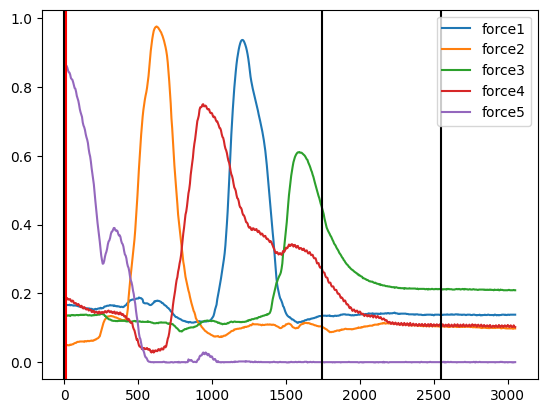

In [163]:
x = subjs_force_exec[(subjs_force_exec['SubNum'] == 3) & (subjs_force_exec['N'] == 410)]
# state_changes = x[x['state'].diff() != 0].index
print(x['board'].unique())

for force, data in x.groupby('Force_Number'):
    plt.plot(data['time'], data['Force_Value'], label = force)





# for i in range(1,6):
#     plt.plot(x['time'], x[f'force{i}'], label = i)

state_changes = x[x['state'].diff() != 0].index

state_changes = x.loc[state_changes]['time'].unique()

for change in state_changes:
    plt.axvline(change, color = 'black')

plt.axvline(x['IPI0'].unique(), color = 'red')


print(state_changes)


# print(x['seq'].unique())


plt.legend()

plt.show()

[0]
[   0.    5.  955. 1760.]


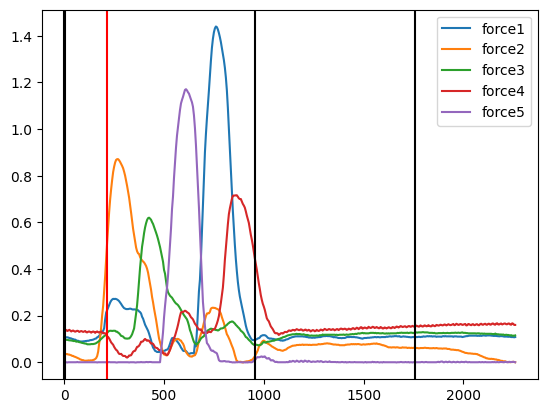

In [164]:
x = subjs_force_exec[(subjs_force_exec['SubNum'] == 1) & (subjs_force_exec['BN'] == 22) & (subjs_force_exec['TN'] == 10)]
# state_changes = x[x['state'].diff() != 0].index
print(x['board'].unique())

for force, data in x.groupby('Force_Number'):
    plt.plot(data['time'], data['Force_Value'], label = force)





# for i in range(1,6):
#     plt.plot(x['time'], x[f'force{i}'], label = i)

state_changes = x[x['state'].diff() != 0].index

state_changes = x.loc[state_changes]['time'].unique()

for change in state_changes:
    plt.axvline(change, color = 'black')

plt.axvline(x['IPI0'].unique(), color = 'red')


print(state_changes)


# print(x['seq'].unique())


plt.legend()

plt.show()

In [10]:
# # subjs_force_exec_cp = subjs_force_exec.copy()
# for sub, subdata in subjs_force_exec.groupby('SubNum'):
#     for bn, bndata in subdata.groupby('BN'):
#         for tn, tndata in bndata.groupby('TN'):
#             for force, data in tndata.groupby('Force_Number'):
#                 baseline = data[data['state'] == 3]['Force_Value'].mean()
#                 # print(data)
#                 subjs_force_exec.loc[data.index, 'Force_Value'] = data['Force_Value'] - baseline

    

[0]
[   0.    5.  955. 1760.]


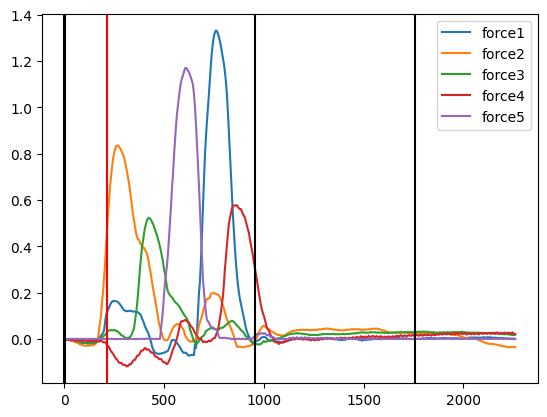

In [11]:
x = subjs_force_exec[(subjs_force_exec['SubNum'] == 1) & (subjs_force_exec['BN'] == 22) & (subjs_force_exec['TN'] == 10)]
# state_changes = x[x['state'].diff() != 0].index
print(x['board'].unique())

for force, data in x.groupby('Force_Number'):
    plt.plot(data['time'], data['Force_Value'], label = force)





# for i in range(1,6):
#     plt.plot(x['time'], x[f'force{i}'], label = i)

state_changes = x[x['state'].diff() != 0].index

state_changes = x.loc[state_changes]['time'].unique()

for change in state_changes:
    plt.axvline(change, color = 'black')

plt.axvline(x['IPI0'].unique(), color = 'red')


print(state_changes)


# print(x['seq'].unique())


plt.legend()

plt.show()

In [17]:
# side_padding = 100
# subjs_force_exec = utils.cut_force(subjs_force_exec, side_padding)

In [73]:
subjs_force_exec_cut = utils.cut_force(subjs_force_exec, 0)
subjs_force_exec_cut_left = utils.cut_force_left(subjs_force_exec)
subjs_force_exec_cut_right = utils.cut_force_right(subjs_force_exec)

In [115]:
def plot_force(subjs_force, subnum, bn, tn):
    plt.figure()
    x = subjs_force[(subjs_force['SubNum'] == subnum) & (subjs_force['BN'] == bn) & (subjs_force['TN'] == tn)]
    for force, data in x.groupby('Force_Number'):
        plt.plot(data['time'], data['Force_Value'], label = force)
    state_changes = x[x['state'].diff() != 0].index
    state_changes = x.loc[state_changes]['time'].unique()
    for change in state_changes:
        plt.axvline(change, color = 'black')

    plt.ylim([-0.2, 2])

    plt.legend()
    plt.show()
    

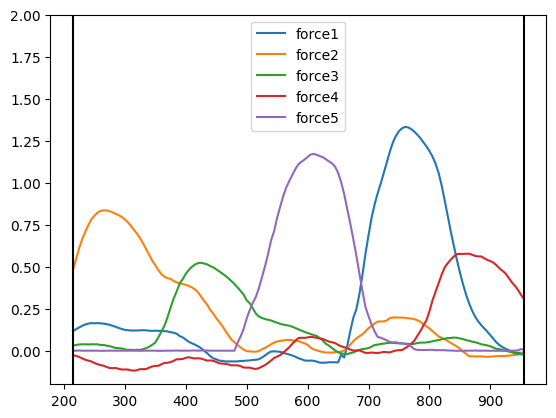

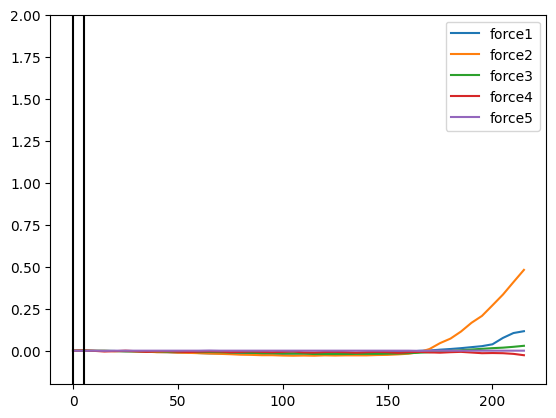

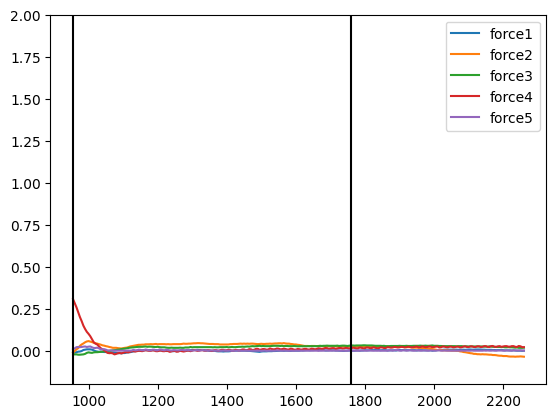

In [116]:
plot_force(subjs_force_exec_cut, 1, 22, 10)
plot_force(subjs_force_exec_cut_left, 1, 22, 10)
plot_force(subjs_force_exec_cut_right, 1, 22, 10)

In [95]:
# n_samples = 300
# n_samples_left_right = 30
# aligned_cut_force = pd.DataFrame(columns=subjs_force_exec.columns)
# interpolated_data = []
# x_center_interp = np.linspace(0, 1, n_samples)
# interval = x_center_interp[1] - x_center_interp[0]
# x_right_interp = np.linspace(x_center_interp[-1] + interval, x_center_interp[-1] + interval * n_samples_left_right, n_samples_left_right) - 1
# x_left_interp = np.linspace(x_center_interp[0] - interval * n_samples_left_right, x_center_interp[0] - interval, n_samples_left_right) + 1


# for sub, subdata in tqdm(subjs_force_exec_cut_left.groupby('SubNum')):
#     for bn, bndata in subdata.groupby('BN'):
#         for tn, tndata in bndata.groupby('TN'):
#             for force, data in tndata.groupby('Force_Number'):
#                 warped_force = np.interp(x_left_interp, np.linspace(0,1, len(data)), data['Force_Value'])

                
#                 interpolated_df = pd.DataFrame({
#                     'SubNum': sub,
#                     'BN': bn,
#                     'TN': tn,
#                     'Force_Number': force,
#                     'Force_Value': warped_force,
#                     'time': x_left_interp  - 1,
#                     'state': data['state'].iloc[0],
#                     'board': data['board'].iloc[0],
#                     'day': data['day'].iloc[0],
#                     'timeReal': data['timeReal'].iloc[0],
#                     'N': data['N'].iloc[0],
#                     'seqType': data['seqType'].iloc[0],
#                     'seqError': data['seqError'].iloc[0],
#                     'trialPoints': data['trialPoints'].iloc[0],
#                     'latePress': data['latePress'].iloc[0],
#                     'hardPress': data['hardPress'].iloc[0]
#                 })
#                 # new_df = pd.concat([new_df, interpolated_df])
#                 interpolated_data.append(interpolated_df)


# for sub, subdata in tqdm(subjs_force_exec_cut.groupby('SubNum')):
#     for bn, bndata in subdata.groupby('BN'):
#         for tn, tndata in bndata.groupby('TN'):
#             for force, data in tndata.groupby('Force_Number'):
#                 warped_force = np.interp(x_center_interp, np.linspace(0,1, len(data)), data['Force_Value'])

                
#                 interpolated_df = pd.DataFrame({
#                     'SubNum': sub,
#                     'BN': bn,
#                     'TN': tn,
#                     'Force_Number': force,
#                     'Force_Value': warped_force,
#                     'time': x_center_interp,
#                     'state': data['state'].iloc[0],
#                     'board': data['board'].iloc[0],
#                     'day': data['day'].iloc[0],
#                     'timeReal': data['timeReal'].iloc[0],
#                     'N': data['N'].iloc[0],
#                     'seqType': data['seqType'].iloc[0],
#                     'seqError': data['seqError'].iloc[0],
#                     'trialPoints': data['trialPoints'].iloc[0],
#                     'latePress': data['latePress'].iloc[0],
#                     'hardPress': data['hardPress'].iloc[0]
#                 })
#                 # new_df = pd.concat([new_df, interpolated_df])
#                 interpolated_data.append(interpolated_df)


# for sub, subdata in tqdm(subjs_force_exec_cut_right.groupby('SubNum')):
#     for bn, bndata in subdata.groupby('BN'):
#         for tn, tndata in bndata.groupby('TN'):
#             for force, data in tndata.groupby('Force_Number'):
#                 warped_force = np.interp(x_right_interp, np.linspace(0,1, len(data)), data['Force_Value'])
                
#                 interpolated_df = pd.DataFrame({
#                     'SubNum': sub,
#                     'BN': bn,
#                     'TN': tn,
#                     'Force_Number': force,
#                     'Force_Value': warped_force,
#                     'time': x_right_interp  + 1,
#                     'state': data['state'].iloc[0],
#                     'board': data['board'].iloc[0],
#                     'day': data['day'].iloc[0],
#                     'timeReal': data['timeReal'].iloc[0],
#                     'N': data['N'].iloc[0],
#                     'seqType': data['seqType'].iloc[0],
#                     'seqError': data['seqError'].iloc[0],
#                     'trialPoints': data['trialPoints'].iloc[0],
#                     'latePress': data['latePress'].iloc[0],
#                     'hardPress': data['hardPress'].iloc[0]
#                 })
#                 # new_df = pd.concat([new_df, interpolated_df])
#                 interpolated_data.append(interpolated_df)




# aligned_cut_force = pd.concat(interpolated_data, ignore_index=True)


100%|██████████| 16/16 [00:42<00:00,  2.68s/it]


In [100]:
# aligned_cut_force.to_csv(utils.path_misc+'aligned_cut_force.csv', index = False, sep = '\t')

In [9]:
aligned_cut_force = pd.read_csv(utils.path_misc+'aligned_cut_force.csv', sep = '\t')

[0]
[-0.10033445  0.          1.00334448]


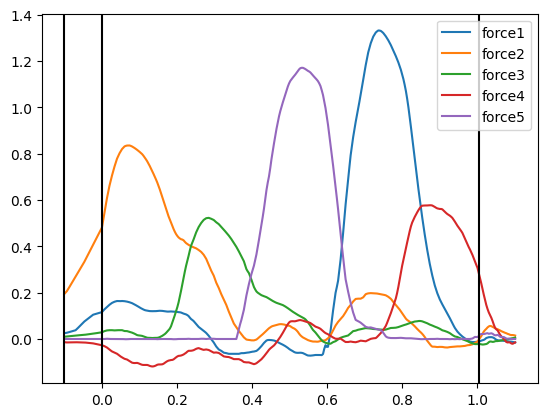

In [8]:
x = aligned_cut_force[(aligned_cut_force['SubNum'] == 1) & (aligned_cut_force['BN'] == 22) & (aligned_cut_force['TN'] == 10)]

# x = x[(x['IPI0'] <= x['time'] + side_padding) & (x['time'] <= x['IPI0'] + x['MT'] + side_padding)]

# state_changes = x[x['state'].diff() != 0].index
print(x['board'].unique())

for force, data in x.groupby('Force_Number'):
    plt.plot(data['time'], data['Force_Value'], label = force)





# for i in range(1,6):
#     plt.plot(x['time'], x[f'force{i}'], label = i)

state_changes = x[x['state'].diff() != 0].index

state_changes = x.loc[state_changes]['time'].unique()

for change in state_changes:
    plt.axvline(change, color = 'black')

print(state_changes)

# print(x['MT'].unique(), x['IPI0'].unique())

# plt.axvline(x['IPI0'].unique(), color = 'red')

# print(x['seq'].unique())


plt.legend()

plt.show()

[1]


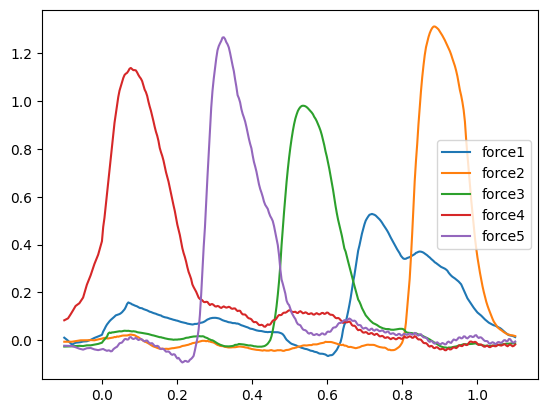

In [97]:
N1 = 23
x1 = aligned_cut_force[(aligned_cut_force['SubNum'] == 6) & (aligned_cut_force['N'] == N1)]
# state_changes = x[x['state'].diff() != 0].index
print(x1['board'].unique())

for force, data in x1.groupby('Force_Number'):
    plt.plot(data['time'], data['Force_Value'], label = force)




# for i in range(1,6):
#     plt.plot(x['time'], x[f'force{i}'], label = i)

# state_changes = x[x['state'].diff() != 0].index

# state_changes = x.loc[state_changes]['time']

# for change in state_changes:
#     plt.axvline(change, color = 'black')


# print(x['seq'].unique())


plt.legend()

plt.show()

[1]


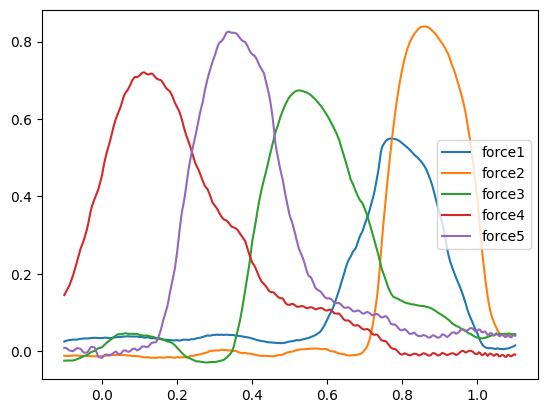

In [98]:
N2 = 895
x2 = aligned_cut_force[(aligned_cut_force['SubNum'] == 6) & (aligned_cut_force['N'] == N2)]
# state_changes = x[x['state'].diff() != 0].index
print(x2['board'].unique())

for force, data in x2.groupby('Force_Number'):
    plt.plot(data['time'], data['Force_Value'], label = force)


# for i in range(1,6):
#     plt.plot(x['time'], x[f'force{i}'], label = i)

# state_changes = x[x['state'].diff() != 0].index

# state_changes = x.loc[state_changes]['time']

# for change in state_changes:
#     plt.axvline(change, color = 'black')


# print(x['seq'].unique())


plt.legend()

plt.show()

In [10]:

forces = [1,2,3,4,5]

num_sequences = 4
num_cores = mp.cpu_count()

all_error_trials = {}


num_trials = 1200

all_error_trials = {}

all_trials_MT = {}

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):


        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            
            error_ranks = subdata[subdata['seqError'] > 0]['N'].unique().astype('int')
            all_error_trials[seqnum, hand, subnum] = error_ranks 




for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            MT = subdata['MT'].to_numpy()
            all_trials_MT[seqnum, hand, subnum] = MT


In [116]:
import ipywidgets as widgets
from IPython.display import display, clear_output
import matplotlib.pyplot as plt
import pandas as pd


class ForceTraceWidget:
    def __init__(self, force_data, subjs_data, window):
        self.force_data = force_data
        self.window = window
        self.subjs_data = subjs_data

        self.force_data['N'] = self.force_data['N'].astype('int')

        # Dropdowns and checkboxes
        # self.bn_dropdown = widgets.Dropdown(
        #     options=sorted(self.data['BN'].unique()),
        #     description='Block Number (BN):'
        # )
        # self.tn_dropdown = widgets.Dropdown(
        #     options=sorted(self.data['TN'].unique()),
        #     description='Trial Number (TN):'
        # )

        self.subj_dropdown = widgets.Dropdown(
            options = self.subjs_data['SubNum'].unique(),
            description='Subject Number:'
        )

        self.N_dropdown = widgets.Dropdown(
            options=sorted(self.force_data['N'].unique()),
            description='N:'
        )
        
        # Button to update the plot
        self.update_button = widgets.Button(description="Update Plot")
        self.update_button.on_click(self.update_plot)
        
        # Display all controls
        display(widgets.VBox([
            # self.bn_dropdown,
            # self.tn_dropdown,
            self.subj_dropdown,
            self.N_dropdown,
            self.update_button
        ]))

        # Output widget for the plot
        self.output = widgets.Output()
        display(self.output)

    def update_plot(self, b):
        # Clear the previous output
        self.output.clear_output()
        
        # Filter data based on user selections
        filtered_data = self.force_data[
            # (self.data['BN'] == self.bn_dropdown.value) &
            # (self.data['TN'] == self.tn_dropdown.value) &
            (self.force_data['SubNum'] == self.subj_dropdown.value) &
            (self.force_data['N'] == self.N_dropdown.value)
        ]


        ET_data = self.subjs_data[
            (self.subjs_data['SubNum'] == self.subj_dropdown.value) 
        ].sort_values(by = 'N')


        with self.output:
            fig = plt.figure(figsize=(30, 5))
            ax = fig.add_axes([0.25, 0.25, 0.5, 0.5])  # Centered with 50% of the figure size
            # Assign colors based on the error flag
            colors = ['red' if is_error else 'blue' for is_error in ET_data['seqError']>0]
            # Plot the execution time
            ax.scatter(ET_data['N'], ET_data['MT'], color=colors, s=10)
            ax.plot(ET_data['N'], ET_data['MT'], color='black', alpha=0.5)


            ax.set_xlabel('N')
            ax.set_xticks(ET_data['N'][::20])
            ax.set_xticklabels(ax.get_xticks(), rotation=45)
            ax.set_ylabel('Execution Time (ET)')
             # Highlight the selected rank
            ax.axvline(self.N_dropdown.value, color='red', linestyle='--')
            # ax.plot(self.rank_dropdown.value, ET_data[ET_data['Rank'] == self.rank_dropdown.value]['norm_MT'], 'ro')
            plt.show()


            
            


        # Plot the filtered data
        with self.output:
            if not filtered_data.empty:
                fig = plt.figure(figsize=(8, 6))
                N = self.N_dropdown.value
                # plt.figure(figsize=(8, 6))
                ET = ET_data[ET_data['N'] == N]['MT'].values[0]
                error_flag = (filtered_data['seqError'] > 0).any()
                for force, data in filtered_data.groupby('Force_Number'):
                    plt.plot(data['time'], data['Force_Value'], label = force)
                    plt.title(f'N: {N} | MT: {ET}')
                    plt.xlim([0,20000])
                    plt.xlabel('Time')
                    plt.ylabel('Force')
                    if error_flag:
                        # axs[ax_ind].set_facecolor('lightcoral')
                        plt.text(0, 0.5, 'Faute', color='red', fontsize=10, ha='center', va='center', alpha=0.5)  # Add error text
                    # axs[ax_ind].grid(True)
                    plt.legend()

                plt.show()

            else:
                print("No data available for the selected filters.")

                        # Connect the click event




# Initialize and display the widget
force_trace_widget = ForceTraceWidget(subjs_force_exec, subjs, 4)


Output()

In [69]:
import ipywidgets as widgets
from IPython.display import display, clear_output
import matplotlib.pyplot as plt
import pandas as pd


class ForceTraceWidget:
    def __init__(self, force_data, subjs_data, window):
        self.force_data = force_data
        self.window = window
        self.subjs_data = subjs_data

        self.force_data['N'] = self.force_data['N'].astype('int')

        # Dropdowns and checkboxes
        # self.bn_dropdown = widgets.Dropdown(
        #     options=sorted(self.data['BN'].unique()),
        #     description='Block Number (BN):'
        # )
        # self.tn_dropdown = widgets.Dropdown(
        #     options=sorted(self.data['TN'].unique()),
        #     description='Trial Number (TN):'
        # )

        self.subj_dropdown = widgets.Dropdown(
            options = self.subjs_data['SubNum'].unique(),
            description='Subject Number:'
        )

        self.N_dropdown = widgets.Dropdown(
            options=sorted(self.force_data['N'].unique()),
            description='N:'
        )
        
        # Button to update the plot
        self.update_button = widgets.Button(description="Update Plot")
        self.update_button.on_click(self.update_plot)
        
        # Display all controls
        display(widgets.VBox([
            # self.bn_dropdown,
            # self.tn_dropdown,
            self.subj_dropdown,
            self.N_dropdown,
            self.update_button
        ]))

        # Output widget for the plot
        self.output = widgets.Output()
        display(self.output)

    def update_plot(self, b):
        # Clear the previous output
        self.output.clear_output()
        
        # Filter data based on user selections
        filtered_data = self.force_data[
            # (self.data['BN'] == self.bn_dropdown.value) &
            # (self.data['TN'] == self.tn_dropdown.value) &
            (self.force_data['SubNum'] == self.subj_dropdown.value) &
            (self.force_data['N'] == self.N_dropdown.value)
        ]


        ET_data = self.subjs_data[
            (self.subjs_data['SubNum'] == self.subj_dropdown.value) 
        ].sort_values(by = 'N')


        with self.output:
            fig = plt.figure(figsize=(30, 5))
            ax = fig.add_axes([0.25, 0.25, 0.5, 0.5])  # Centered with 50% of the figure size
            # Assign colors based on the error flag
            colors = ['red' if is_error else 'blue' for is_error in ET_data['seqError']>0]
            # Plot the execution time
            ax.scatter(ET_data['N'], ET_data['MT'], color=colors, s=10)
            ax.plot(ET_data['N'], ET_data['MT'], color='black', alpha=0.5)


            ax.set_xlabel('N')
            ax.set_xticks(ET_data['N'][::20])
            ax.set_xticklabels(ax.get_xticks(), rotation=45)
            ax.set_ylabel('Execution Time (ET)')
             # Highlight the selected rank
            ax.axvline(self.N_dropdown.value, color='red', linestyle='--')
            # ax.plot(self.rank_dropdown.value, ET_data[ET_data['Rank'] == self.rank_dropdown.value]['norm_MT'], 'ro')
            plt.show()


            
            


        # Plot the filtered data
        with self.output:
            if not filtered_data.empty:
                fig = plt.figure(figsize=(8, 6))
                N = self.N_dropdown.value
                # plt.figure(figsize=(8, 6))
                ET = ET_data[ET_data['N'] == N]['MT'].values[0]
                error_flag = (filtered_data['seqError'] > 0).any()
                for force, data in filtered_data.groupby('Force_Number'):
                    plt.plot(data['time'], data['Force_Value'], label = force)
                    plt.title(f'N: {N} | MT: {ET}')
                    plt.xlim([-0.1, 1.1])
                    plt.xlabel('Time')
                    plt.ylabel('Force')
                    if error_flag:
                        # axs[ax_ind].set_facecolor('lightcoral')
                        plt.text(0, 0.5, 'Faute', color='red', fontsize=10, ha='center', va='center', alpha=0.5)  # Add error text
                    # axs[ax_ind].grid(True)
                    plt.legend()

                plt.show()

            else:
                print("No data available for the selected filters.")

                        # Connect the click event




# Initialize and display the widget
force_trace_widget = ForceTraceWidget(aligned_cut_force, subjs, 4)


Output()

# Frobenius norm  and Clustering

In [11]:
from numba import njit
@njit
def compute_frobenius(col1, col2):
    dist_squared = np.sum((col1 - col2) ** 2)
    dist = np.sqrt(dist_squared)
    return dist


In [12]:
@njit 
def compute_covariance(col1, col2, mean):
    return np.dot(col1.flatten() - mean, col2.flatten() - mean)

In [1214]:
from collections import defaultdict
forces = [1,2,3,4,5]
import pickle


auto_cov_dict = {}

num_sequences = 4
num_cores = mp.cpu_count()




num_trials = 1200


seq_types = subjs['seqType'].unique()

for seqnum, seq_data in aligned_cut_force.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            pivot_data = subdata.pivot_table(index = ['time', 'Force_Number'], columns = ['N'], values = 'Force_Value')
        
            ranks = pivot_data.columns.get_level_values('N').unique()
            correct_ranks = ranks[~ranks.isin(all_error_trials[seqnum, hand, subnum])]
            # distances = np.empty((len(correct_ranks), len(correct_ranks)))
            covs = defaultdict(list)
            # distances = pd.DataFrame(index = correct_ranks.values.astype('int'), columns= correct_ranks.values.astype('int'),
            #                             dtype='float')

            mean_force = pivot_data.mean(axis=1)
            #subtract mean_force from data:

            for col1idx, col1 in enumerate(tqdm(correct_ranks,
                                                desc = f"Processing sub {subnum}seq {seqnum} hand {hand}", leave=False)):
                for col2idx, col2 in enumerate(correct_ranks):
                    if col2idx >= col1idx:
                        inner_product = compute_covariance(pivot_data[col1].to_numpy(), pivot_data[col2].to_numpy(), mean_force.to_numpy())
                        covs[col2 - col1].append(inner_product)
                        # distances[col1idx, col2idx] = distance
                        # distances[col2idx, col1idx] = distance
            auto_cov_dict[seqnum, hand, subnum] = covs


with open(utils.path_misc + 'cov_dict.pkl', 'wb') as f:
    pickle.dump(auto_cov_dict, f)     
        # sns.heatmap(corrs, cmap = 'coolwarm', vmin = 0, vmax = 1, ax = axs[seqnum-1, hand])


# np.save(utils.path_misc + 'all_corrs_corr.npy', all_corrs_corr)

In [12]:
import pickle
with open(utils.path_misc + 'cov_dict.pkl', 'rb') as f:
    auto_cov_dict = pickle.load(f)

/var/folders/wg/16zn32014z5grhdv06dk49f00000gn/T/ipykernel_2343/3547692714.py:6: RuntimeWarning: Mean of empty slice
  y  = [np.nanmean(inner_products[key]) for key in x]


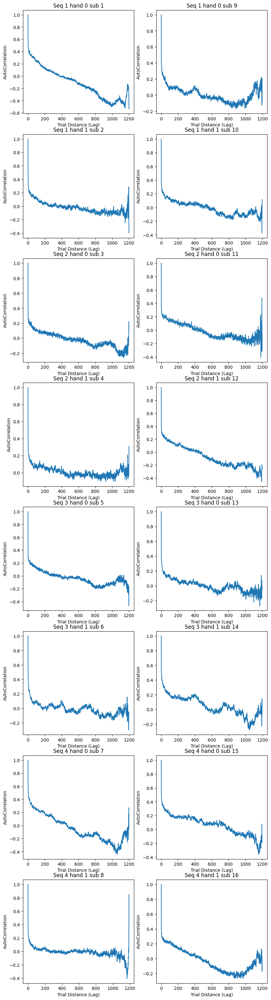

In [13]:
from collections import defaultdict

fig , axs = plt.subplots(4 * 2, 2, figsize = (10, 40))
for idx, ((seqnum, hand, subnum), inner_products) in enumerate(auto_cov_dict.items()):
    x = np.sort(list(inner_products.keys()))
    y  = [np.nanmean(inner_products[key]) for key in x]
    y /= y[0]
    # yerr = [np.std(similarities_distance_dict[key]) / np.sqrt(len(similarities_distance_dict[key])) for key in x]

    ax_ind = (idx // 2, idx % 2)

    # axs[ax_ind].errorbar(x, y, yerr = yerr)
    axs[ax_ind].plot(x, y)
    axs[ax_ind].set_xlabel('Trial Distance (Lag)')
    axs[ax_ind].set_ylabel('AutoCorrelation')

    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

In [102]:

forces = [1,2,3,4,5]
import pickle


distances_dict = {}

num_sequences = 4
num_cores = mp.cpu_count()




# num_trials = 1200


seq_types = subjs['seqType'].unique()

for seqnum, seq_data in aligned_cut_force.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            pivot_data = subdata.pivot_table(index = ['time'], columns = ['N', 'Force_Number'], values = 'Force_Value')
        
            ranks = pivot_data.columns.get_level_values('N').unique()
            correct_ranks = ranks[~ranks.isin(all_error_trials[seqnum, hand, subnum])]
            # distances = np.empty((len(correct_ranks), len(correct_ranks)))
            distances = pd.DataFrame(index = correct_ranks.values.astype('int'), columns= correct_ranks.values.astype('int'),
                                        dtype='float')

            
            for col1idx, col1 in enumerate(tqdm(correct_ranks,
                                                desc = f"Processing sub {subnum}seq {seqnum} hand {hand}", leave=False)):
                for col2idx, col2 in enumerate(correct_ranks):
                    if col2idx >= col1idx:
                        distance = compute_frobenius(pivot_data[col1].to_numpy(), pivot_data[col2].to_numpy())
                        distances.loc[col1, col2] = distance
                        distances.loc[col2, col1] = distance
                        # distances[col1idx, col2idx] = distance
                        # distances[col2idx, col1idx] = distance
            distances_dict[seqnum, hand, subnum] = distances


        
        # sns.heatmap(corrs, cmap = 'coolwarm', vmin = 0, vmax = 1, ax = axs[seqnum-1, hand])

with open(utils.path_misc + 'distances_dict.pkl', 'wb') as f:
    pickle.dump(distances_dict, f)


# np.save(utils.path_misc + 'all_corrs_corr.npy', all_corrs_corr)

In [13]:
import pickle
with open(utils.path_misc + 'distances_dict.pkl', 'rb') as f:
    distances_dict = pickle.load(f)


distances_dict[(4,1,8)] = distances_dict[(4,1,8)].dropna(how = 'all').dropna(axis = 1)

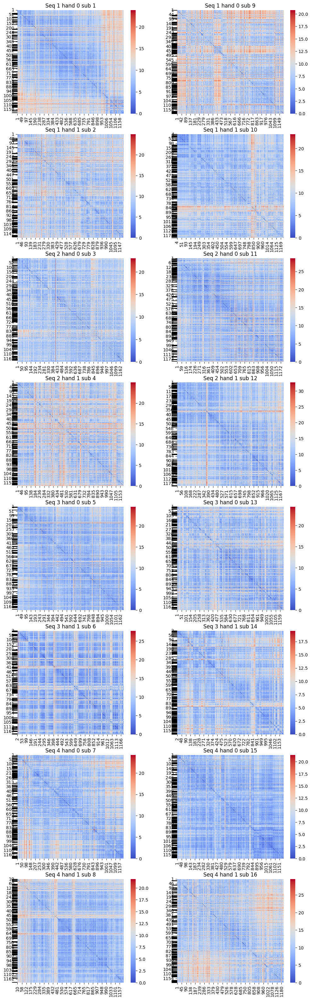

In [14]:
fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))
for idx, ((seqnum, hand, subnum), distances) in enumerate(distances_dict.items()):
    error_trials = all_error_trials[(seqnum, hand, subnum)]
    sns.heatmap(distances, cmap = 'coolwarm', ax=axs[idx //2 , idx % 2])
    for trial in error_trials:
        axs[idx//2, idx % 2].annotate('', xy = (0, trial), xytext = (-1, trial), arrowprops = dict(facecolor = 'green', shrink = 0.05, headwidth = 0.1))
    axs[idx//2, idx % 2].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

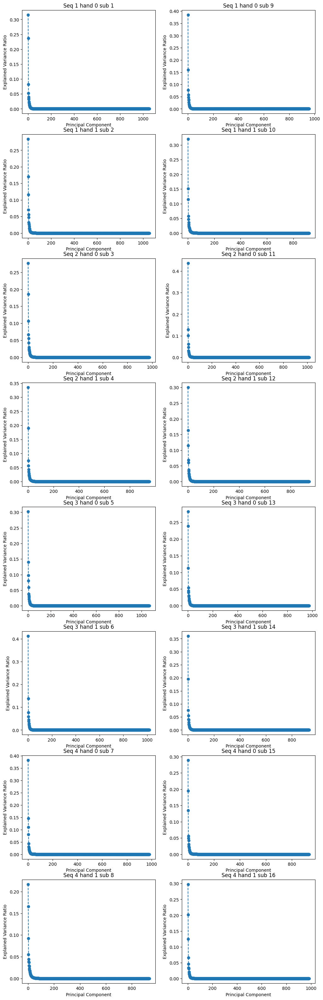

In [81]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()

reduced_forces_correct_dict = {}
reduced_forces_all_dict = {}

n_dim_reduction = 15


# num_trials = 1200


seq_types = subjs['seqType'].unique()

for seqnum, seq_data in aligned_cut_force.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            subdata_correct = utils.remove_error_trials(subdata)
            pivot_data = subdata_correct.pivot_table(index = ['N'], columns = ['Force_Number', 'time'], values = 'Force_Value').dropna().to_numpy()
            pca = PCA()
            pca.fit(pivot_data)

            explained_variance = pca.explained_variance_ratio_
            dim_reduced = np.argmax(np.cumsum(explained_variance) >= 0.9)
            # print(dim_reduced)

            reduced_forces_correct_dict[seqnum, hand, subnum] = pca.transform(pivot_data)[:,:n_dim_reduction]
            pivot_data = subdata.pivot_table(index = ['N'], columns = ['Force_Number', 'time'], values = 'Force_Value').dropna().to_numpy()
            reduced_forces_all_dict[seqnum, hand, subnum] = pca.transform(pivot_data)[:,:n_dim_reduction]


            seq_ind = seqnum - 1
            ax_ind = (seq_ind * 2 + hand, subind)
            axs[ax_ind].plot(np.arange(1, len(explained_variance) + 1), explained_variance, marker = 'o', linestyle = '--')
            # axs[ax_ind].set_yscale('log')
            axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
            axs[ax_ind].set_xlabel('Principal Component')
            axs[ax_ind].set_ylabel('Explained Variance Ratio')
            # axs[ax_ind].set_ylim([1e-3, 1])

            

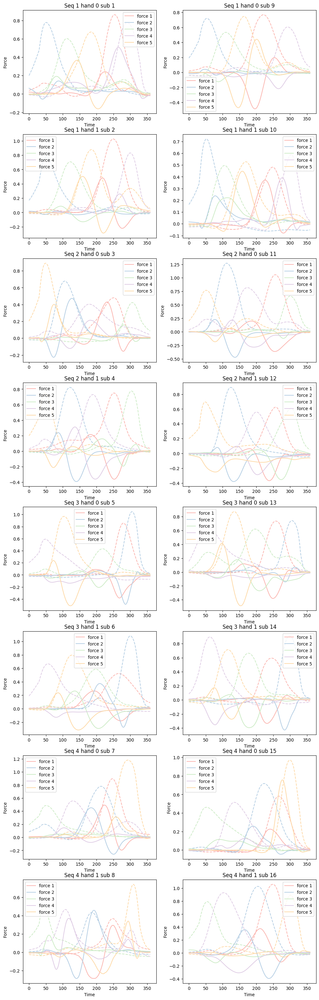

In [32]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()

component_rank = 0

cmap = cm.Pastel1

# num_trials = 1200


seq_types = subjs['seqType'].unique()

for seqnum, seq_data in aligned_cut_force.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            subdata = utils.remove_error_trials(subdata)
            pivot_data = subdata.pivot_table(index = ['N'], columns = ['Force_Number', 'time'], values = 'Force_Value').dropna().to_numpy()
            pca = PCA()
            pca.fit(pivot_data)

            forces = pca.components_[component_rank].reshape(len(fingers), n_samples_left_right * 2 + n_samples)

            seq_ind = seqnum - 1
            ax_ind = (seq_ind * 2 + hand, subind)


            # mean force profile
            mean_forces = np.mean(pivot_data, axis = 0).reshape(len(fingers), n_samples_left_right * 2 + n_samples)
            for force_ind, force in enumerate(mean_forces):
                axs[ax_ind].plot(force, linestyle = '--', color = cmap(force_ind))    
            # Plotting principal components
            for force_ind, force in enumerate(forces):
                axs[ax_ind].plot(force * 5, label = f'force {force_ind + 1}', color = cmap(force_ind))
            axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
            axs[ax_ind].set_xlabel('Time')
            axs[ax_ind].set_ylabel('Force')
            axs[ax_ind].legend()

            

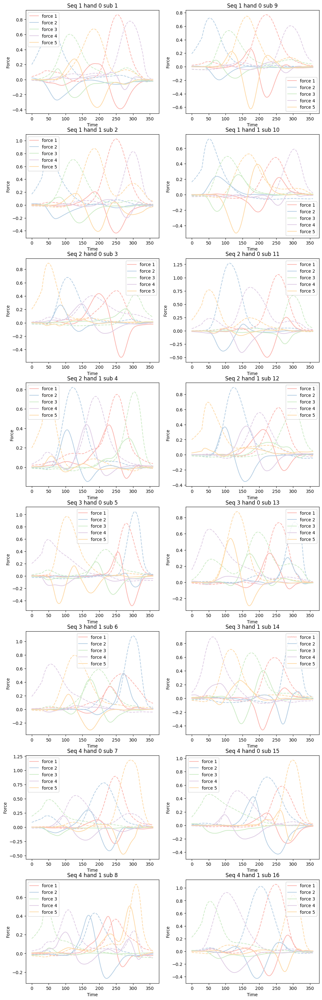

In [33]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()

component_rank = 1

cmap = cm.Pastel1

# num_trials = 1200


seq_types = subjs['seqType'].unique()

for seqnum, seq_data in aligned_cut_force.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            subdata = utils.remove_error_trials(subdata)
            pivot_data = subdata.pivot_table(index = ['N'], columns = ['Force_Number', 'time'], values = 'Force_Value').dropna().to_numpy()
            pca = PCA()
            pca.fit(pivot_data)

            forces = pca.components_[component_rank].reshape(len(fingers), n_samples_left_right * 2 + n_samples)

            seq_ind = seqnum - 1
            ax_ind = (seq_ind * 2 + hand, subind)


            # mean force profile
            mean_forces = np.mean(pivot_data, axis = 0).reshape(len(fingers), n_samples_left_right * 2 + n_samples)
            for force_ind, force in enumerate(mean_forces):
                axs[ax_ind].plot(force, linestyle = '--', color = cmap(force_ind))    
            # Plotting principal components
            for force_ind, force in enumerate(forces):
                axs[ax_ind].plot(force * 5, label = f'force {force_ind + 1}', color = cmap(force_ind))
            axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
            axs[ax_ind].set_xlabel('Time')
            axs[ax_ind].set_ylabel('Force')
            axs[ax_ind].legend()

            

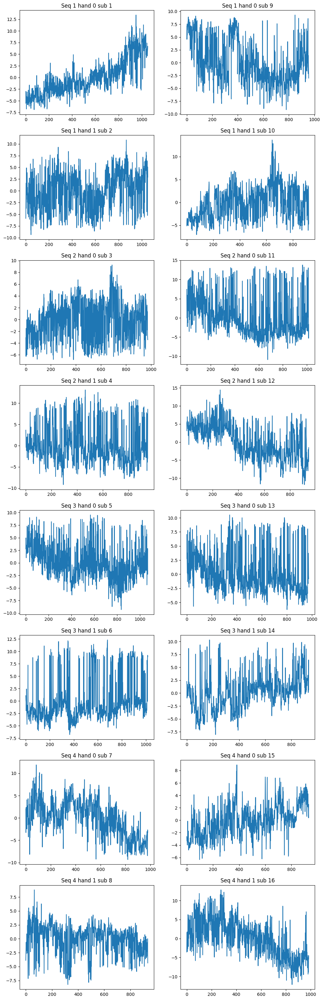

In [198]:
fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))

component_rank = 0

for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_correct_dict.items()):
    plot_ind = (idx//2, idx % 2)
    axs[plot_ind].plot(forces[:,component_rank])
    axs[plot_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

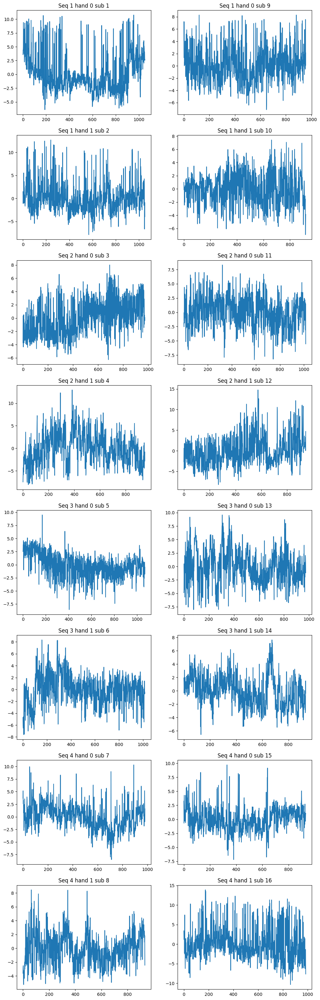

In [201]:
fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))

component_rank = 1

for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_correct_dict.items()):
    plot_ind = (idx//2, idx % 2)
    axs[plot_ind].plot(forces[:,component_rank])
    axs[plot_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

In [222]:
#project and plot random walk on the first 3 principal components interactively in 3D
import plotly.graph_objects as go

for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_correct_dict.items()):
    #change color of lines continuously with index
    color = np.arange(len(forces))
    fig = go.Figure(data=[go.Scatter3d(x=forces[:,0], y=forces[:,1], z=forces[:,2], mode='lines', line=dict(color=color, colorscale='Viridis', width=1, showscale = True))])
    #show color progression in colorbar
    # fig.update_layout(coloraxis_colorbar=dict(title='Index', tickvals=[0, len(forces)], ticktext=['Start', 'End']))

    # fig = go.Figure(data=[go.Scatter3d(x=forces[:,0], y=forces[:,1], z=forces[:,2], mode='lines')])
    fig.update_layout(scene = dict(
                        xaxis_title='PC1',
                        yaxis_title='PC2',
                        zaxis_title='PC3'), 
                        width=800,
                        height=800, 
                        margin=dict(l=100, r=100, b = 100, t=100),
                        title_text = f'Seq {seqnum} hand {hand} sub {subnum}')
                        
    fig.show()




In [223]:
#project and plot random walk on the first 3 principal components interactively in 3D
import plotly.graph_objects as go
from pykalman import KalmanFilter

reduced_forces_correct_smoothed = {}

for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_correct_dict.items()):
    kf = KalmanFilter(n_dim_state = n_dim_reduction, n_dim_obs = n_dim_reduction, transition_matrices=np.eye(n_dim_reduction), observation_matrices = np.eye(n_dim_reduction), 
                transition_offsets = np.zeros(n_dim_reduction), observation_offsets = np.zeros(n_dim_reduction), initial_state_mean=forces[0], initial_state_covariance=np.zeros((n_dim_reduction, n_dim_reduction)),
                em_vars=['transition_covariance', 'observation_covariance'])
    kf = kf.em(forces, n_iter=5)
    smoothed_states, _ = kf.smooth(forces)
    reduced_forces_correct_smoothed[seqnum, hand, subnum] = smoothed_states

    #change color of lines continuously with index
    color = np.arange(len(forces))
    fig = go.Figure(data=[go.Scatter3d(x=smoothed_states[:,0], y=smoothed_states[:,1], z=smoothed_states[:,2], mode='lines', line=dict(color=color, colorscale='Viridis', width=1, showscale = True))])
    #show color progression in colorbar
    # fig.update_layout(coloraxis_colorbar=dict(title='Index', tickvals=[0, len(forces)], ticktext=['Start', 'End']))

    # fig = go.Figure(data=[go.Scatter3d(x=forces[:,0], y=forces[:,1], z=forces[:,2], mode='lines')])
    fig.update_layout(scene = dict(
                        xaxis_title='PC1',
                        yaxis_title='PC2',
                        zaxis_title='PC3'), 
                        width=800,
                        height=800, 
                        margin=dict(l=100, r=100, b = 100, t=100),
                        title_text = f'Seq {seqnum} hand {hand} sub {subnum}')
                        
    fig.show()




In [257]:
#project and plot random walk on the first 3 principal components interactively in 3D
import plotly.graph_objects as go
from pykalman import KalmanFilter
import numpy.ma as ma


reduced_forces_all_smoothed = {}

for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_all_dict.items()):
    if subnum != 8:
        kf = KalmanFilter(n_dim_state = n_dim_reduction, n_dim_obs = n_dim_reduction, transition_matrices=np.eye(n_dim_reduction), observation_matrices = np.eye(n_dim_reduction), 
                    transition_offsets = np.zeros(n_dim_reduction), observation_offsets = np.zeros(n_dim_reduction), initial_state_mean=forces[0], initial_state_covariance=np.zeros((n_dim_reduction, n_dim_reduction)),
                    em_vars=['transition_covariance', 'observation_covariance'])
        

        error_inds = all_error_trials[(seqnum, hand, subnum)]
        mask = np.zeros_like(forces)
        mask[error_inds-1, :] = 1
        forces = ma.masked_array(forces, mask)
        kf = kf.em(forces, n_iter=5)
        smoothed_states, _ = kf.smooth(forces)
        reduced_forces_all_smoothed[seqnum, hand, subnum] = smoothed_states

        #change color of lines continuously with index
        color = np.arange(len(forces))
        fig = go.Figure(data=[go.Scatter3d(x=smoothed_states[:,0], y=smoothed_states[:,1], z=smoothed_states[:,2], mode='lines', line=dict(color=color, colorscale='Viridis', width=1, showscale = True))])
        #show color progression in colorbar
        # fig.update_layout(coloraxis_colorbar=dict(title='Index', tickvals=[0, len(forces)], ticktext=['Start', 'End']))

        # fig = go.Figure(data=[go.Scatter3d(x=forces[:,0], y=forces[:,1], z=forces[:,2], mode='lines')])
        fig.update_layout(scene = dict(
                            xaxis_title='PC1',
                            yaxis_title='PC2',
                            zaxis_title='PC3'), 
                            width=800,
                            height=800, 
                            margin=dict(l=100, r=100, b = 100, t=100),
                            title_text = f'Seq {seqnum} hand {hand} sub {subnum}')
                            
        fig.show()




In [203]:
aligned_cut_force['trialPoints'].mean()

0.7991848286099982

In [219]:
all_avg_distances.keys()

dict_keys([-1, 0, 1, 3])

In [316]:
(forces[:, np.newaxis, :] - forces[np.newaxis, :, :])[2,1]

array([ 0.55605354, -0.38979244, -0.14684183, -0.29316208,  0.24546046,
       -0.35256169,  0.23325658,  0.84650225,  0.24024237,  0.19740504,
        1.4248236 ,  0.04518884, -0.39617133, -0.68235236, -0.29659894])

In [318]:
forces[2] - forces[1]

array([ 0.55605354, -0.38979244, -0.14684183, -0.29316208,  0.24546046,
       -0.35256169,  0.23325658,  0.84650225,  0.24024237,  0.19740504,
        1.4248236 ,  0.04518884, -0.39617133, -0.68235236, -0.29659894])

In [304]:
np.mean(forces, axis=0)

(15,)

In [322]:
np.linalg.norm((forces[:, np.newaxis, :] - forces[np.newaxis, :, :]), axis = 2).shape

(1200, 1200)

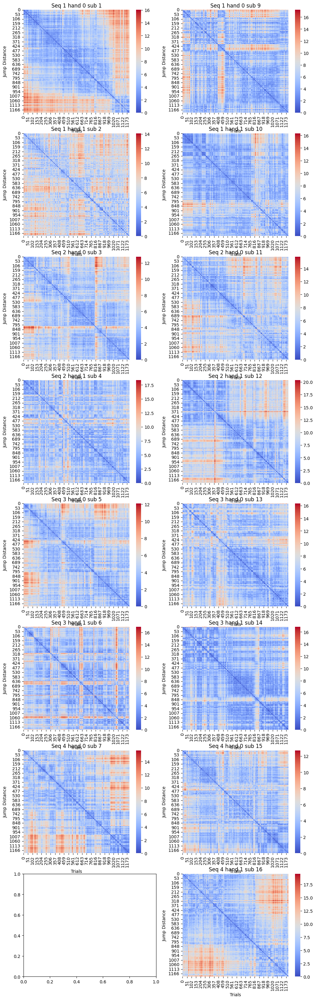

In [324]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

seq_types = subjs['seqType'].unique()

smoothed_distances_dict = {}

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):

            seq_ind = seqnum - 1
            ax_ind = (seq_ind * 2 + hand, subind)

            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]
                distances = np.linalg.norm((forces[:, np.newaxis, :] - forces[np.newaxis, :, :]), axis = 2)
                smoothed_distances_dict[seqnum, hand, subnum] = distances
                sns.heatmap(distances, cmap = 'coolwarm', ax=axs[ax_ind])


                axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
                axs[ax_ind].set_xlabel('Trials')
                axs[ax_ind].set_ylabel('Jump Distance')


            

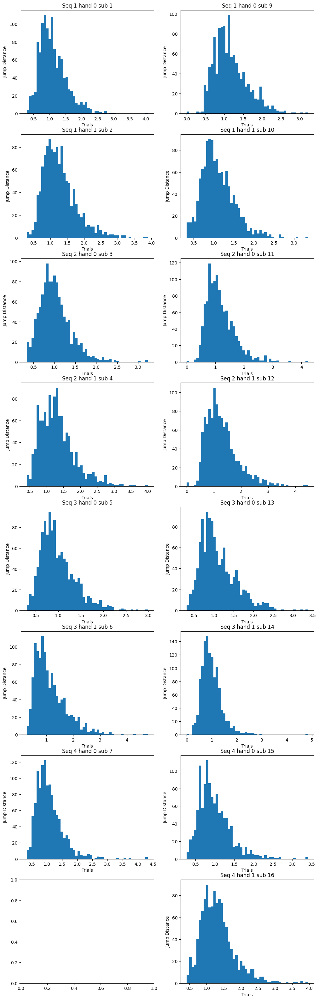

In [335]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]

                #calculate euclidean distance between all consecutive trials
                distances = np.empty((forces.shape[0] - 1))
                for i in range(forces.shape[0] - 1):
                    distances[i] = np.linalg.norm(forces[i] - forces[i + 1])

                seq_ind = seqnum - 1
                ax_ind = (seq_ind * 2 + hand, subind)

                axs[ax_ind].hist(distances, bins = 50)
                    # avg_distances.append(np.mean(distances[trial_points == point]))
                    # std_distances.append(np.std(distances[trial_points == point]))

                # axs[ax_ind].errorbar(unique_points, avg_distances, yerr = std_distances, fmt = 'o', color = 'black')

                axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
                axs[ax_ind].set_xlabel('Trials')
                axs[ax_ind].set_ylabel('Jump Distance')
                # axs[ax_ind].legend()
# plt.figure()
# plt.errorbar(all_avg_distances.keys(), [np.mean(val) for val in all_avg_distances.values()], yerr = [np.std(val) for val in all_avg_distances.values()], fmt = 'o', color = 'black', 
#              capsize = 5)
# plt.xticks(list(all_avg_distances.keys()))
# plt.xlabel('Points')
# plt.ylabel('Jump Distance')

            

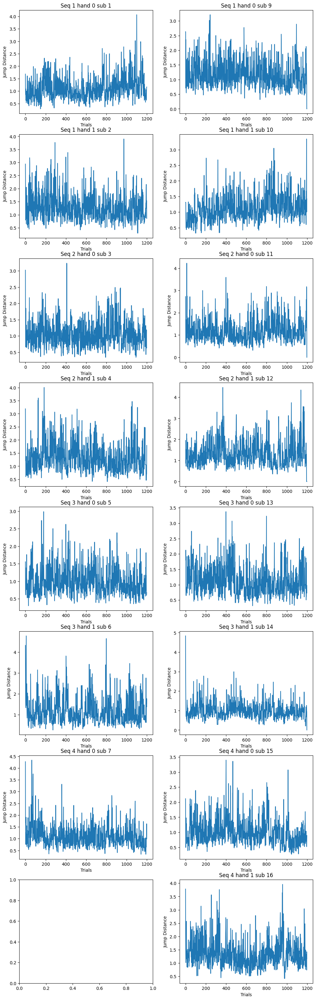

In [297]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]

                #calculate euclidean distance between all consecutive trials
                distances = np.empty((forces.shape[0] - 1))
                for i in range(forces.shape[0] - 1):
                    distances[i] = np.linalg.norm(forces[i] - forces[i + 1])

                seq_ind = seqnum - 1
                ax_ind = (seq_ind * 2 + hand, subind)

                axs[ax_ind].plot(distances)
                    # avg_distances.append(np.mean(distances[trial_points == point]))
                    # std_distances.append(np.std(distances[trial_points == point]))

                # axs[ax_ind].errorbar(unique_points, avg_distances, yerr = std_distances, fmt = 'o', color = 'black')

                axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
                axs[ax_ind].set_xlabel('Trials')
                axs[ax_ind].set_ylabel('Jump Distance')
                # axs[ax_ind].legend()
# plt.figure()
# plt.errorbar(all_avg_distances.keys(), [np.mean(val) for val in all_avg_distances.values()], yerr = [np.std(val) for val in all_avg_distances.values()], fmt = 'o', color = 'black', 
#              capsize = 5)
# plt.xticks(list(all_avg_distances.keys()))
# plt.xlabel('Points')
# plt.ylabel('Jump Distance')

            

Text(0, 0.5, 'AutoCorrelation')

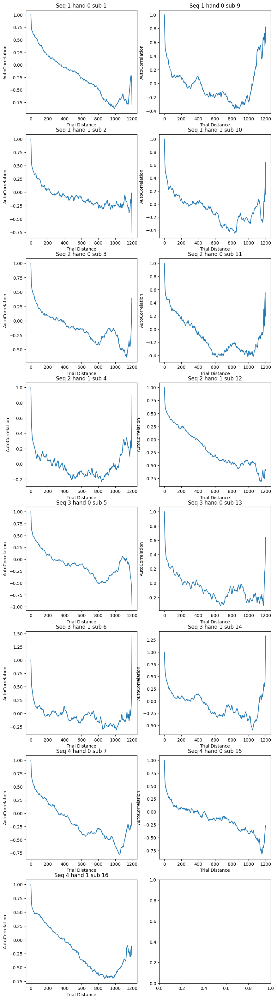

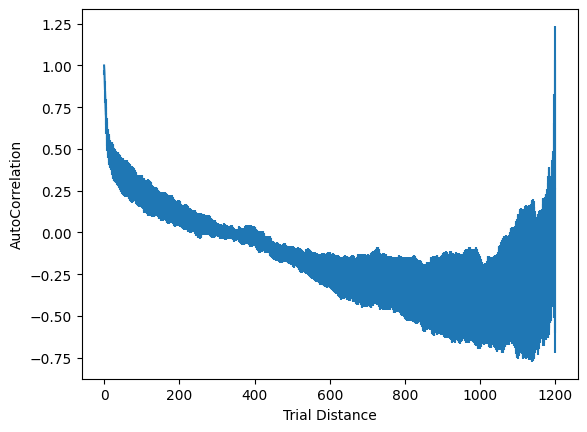

In [418]:
from collections import defaultdict
fig , axs = plt.subplots(4 * 2, 2, figsize = (10, 40))
all_covs_dict = defaultdict(list)
for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_all_smoothed.items()):
    covs = defaultdict(list)
    mean_force = np.mean(forces, axis = 0)
    for trial1, force1 in enumerate(forces):
        for trial2, force2 in enumerate(forces):
            if trial2 >= trial1:
                inner_product = compute_covariance(force1, force2, mean_force)
                covs[trial2 - trial1].append(inner_product)


    ax_ind = (idx // 2, idx % 2)

    x = np.sort(list(covs.keys()))
    y = [np.nanmean(covs[key]) for key in x]
    y /= y[0]

    for key in x:
        all_covs_dict[key].append(np.nanmedian(covs[key]) / np.nanmedian(covs[0]))

    # axs[ax_ind].errorbar(x, y, yerr = yerr)
    axs[ax_ind].plot(x, y)
    axs[ax_ind].set_xlabel('Trial Distance')
    axs[ax_ind].set_ylabel('AutoCorrelation')

    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

plt.figure()
x = np.sort(list(all_covs_dict.keys()))
y = [np.nanmean(all_covs_dict[key]) for key in x]
yerr = [np.nanstd(all_covs_dict[key]) for key in x]
plt.errorbar(x, y, yerr = yerr)
plt.xlabel('Trial Distance')
plt.ylabel('AutoCorrelation')



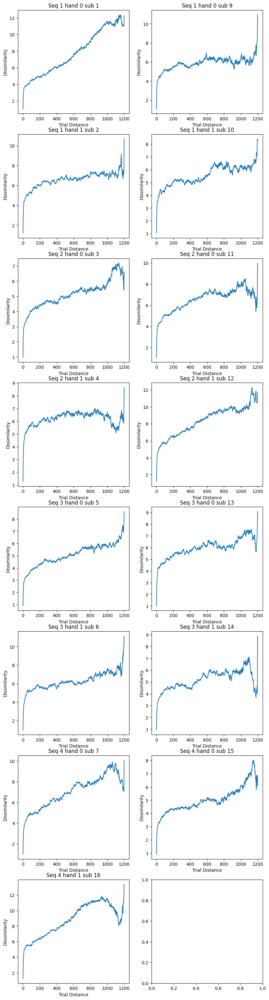

In [414]:
from collections import defaultdict
fig , axs = plt.subplots(4 * 2, 2, figsize = (10, 40))
for idx, ((seqnum, hand, subnum), distances) in enumerate(smoothed_distances_dict.items()):
    similarities_distance_dict = defaultdict(list)
    for trial1, row in enumerate(distances):
        for trial2, distance in enumerate(row):
            if trial2 > trial1:
                similarities_distance_dict[trial2 - trial1].append(distance)
    x = np.sort(list(similarities_distance_dict.keys()))
    y  = [np.median(similarities_distance_dict[key]) for key in x]
    # yerr = [np.std(similarities_distance_dict[key]) / np.sqrt(len(similarities_distance_dict[key])) for key in x]

    ax_ind = (idx // 2, idx % 2)

    # axs[ax_ind].errorbar(x, y, yerr = yerr)
    axs[ax_ind].plot(x, y)
    axs[ax_ind].set_xlabel('Trial Distance')
    axs[ax_ind].set_ylabel('Dissimilarity')

    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

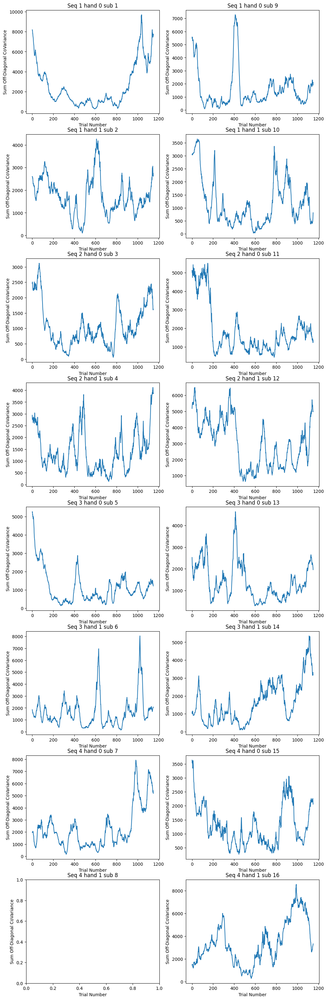

In [452]:

fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))
# smoothed_corrs = np.zeros(all_corrs_corr.shape[:-1])
avg_window = 50
window = np.ones(avg_window) / avg_window



for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_all_dict.items()):
    ax_ind = (idx // 2, idx % 2)
    if subnum != 8:
        moving_cov = [np.cov(forces[trial:trial + avg_window]) for trial in range(len(forces) - avg_window + 1)]
        moving_off_var = [np.sum(cov) - np.trace(cov) for cov in moving_cov]
        axs[ax_ind].plot(moving_off_var)
        # print(len(moving_off_var))

    # # for trial in error_trials:
    # #     axs[ax_ind].axvline(trial, color = 'red', linestyle = '--', alpha = 0.1)

    axs[ax_ind].set_xlabel('Trial Number')
    axs[ax_ind].set_ylabel('Sum Off-Diagonal CoVariance')
    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')


                


In [458]:
np.linalg.norm(moving_cov[0])

101.93986816731268

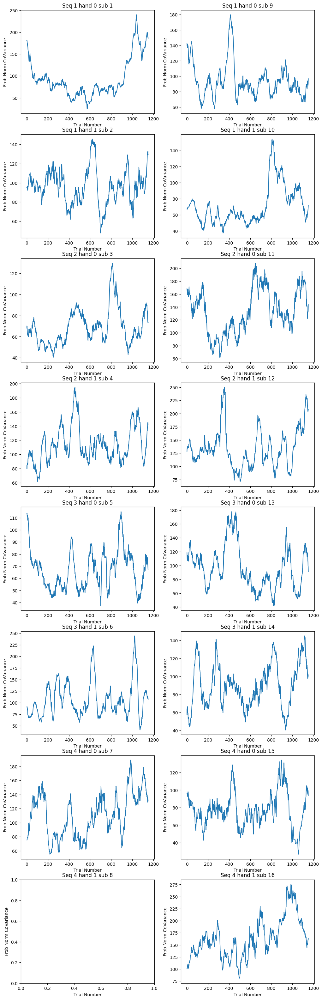

In [461]:

fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))
# smoothed_corrs = np.zeros(all_corrs_corr.shape[:-1])
avg_window = 50
window = np.ones(avg_window) / avg_window



for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_all_dict.items()):
    ax_ind = (idx // 2, idx % 2)
    if subnum != 8:
        moving_cov = [np.cov(forces[trial:trial + avg_window]) for trial in range(len(forces) - avg_window + 1)]
        moving_off_var = [np.linalg.norm(cov) for cov in moving_cov]
        # moving_off_var = [np.sum(cov) - np.trace(cov) for cov in moving_cov]

        axs[ax_ind].plot(moving_off_var)
        # print(len(moving_off_var))

    # # for trial in error_trials:
    # #     axs[ax_ind].axvline(trial, color = 'red', linestyle = '--', alpha = 0.1)

    axs[ax_ind].set_xlabel('Trial Number')
    axs[ax_ind].set_ylabel('Frob Norm CoVariance')
    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')


                


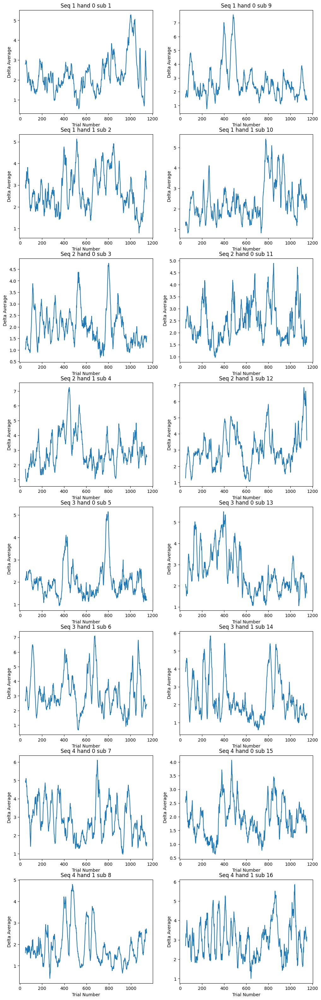

In [363]:

fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))
# smoothed_corrs = np.zeros(all_corrs_corr.shape[:-1])
avg_window = 50



for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_all_dict.items()):
    avg_forces_left = {}
    avg_forces_right = {}
    delta_avg = {}
    for trial_idx, row in enumerate(forces):
        if trial_idx >= avg_window and trial_idx < len(forces) - avg_window:
            avg_forces_left[trial_idx] = np.mean(forces[trial_idx - avg_window: trial_idx], axis = 0)
            avg_forces_right[trial_idx] = np.mean(forces[trial_idx + 1: trial_idx + avg_window + 1], axis = 0)
            delta_avg[trial_idx] = np.linalg.norm(avg_forces_left[trial_idx] - avg_forces_right[trial_idx])


    ax_ind = (idx // 2, idx % 2)
    axs[ax_ind].plot(list(delta_avg.keys()), list(delta_avg.values()))
    # error_trials = all_error_trials[(seqnum, hand, subnum)]
    # for trial in error_trials:
    #     axs[ax_ind].axvline(trial, color = 'red', linestyle = '--', alpha = 0.1)

    axs[ax_ind].set_xlabel('Trial Number')
    axs[ax_ind].set_ylabel('Delta Average')
    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')


# for seq in range(4):
#     for hand in range(2):
#         for subnum in range(total_sub_num//(4*2)):
#             for trial in range(num_trials):
#                 smoothed_corrs[seq, hand, subnum, trial] = np.convolve(all_corrs_corr[seq, hand, subnum, trial], window, mode='same')[trial]
#             subplot_idx = (seq *2 + hand, subnum)
#             axs[subplot_idx].scatter(all_error_trials[seq, hand, subnum], smoothed_corrs[seq, hand, subnum][all_error_trials[seq, hand, subnum]], color = 'red')
#             axs[subplot_idx].plot(smoothed_corrs[seq, hand, subnum])
#             axs[subplot_idx].set_ylim([0,1])

#             axs[subplot_idx].set_title(f'Seq {seq} hand {hand} Sub {subnum}')

                


<Axes: >

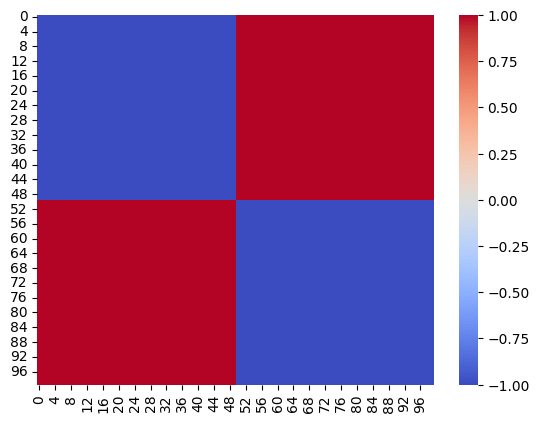

In [372]:
n = 50
filter = np.zeros((2 * n, 2 * n))

filter[:n, :n] = -1
filter[n:, n:] = -1

filter[:n, n:] = 1
filter[n:, :n] = 1
filter
sns.heatmap(filter, cmap = 'coolwarm')

100%|██████████| 15/15 [04:56<00:00, 19.78s/it]


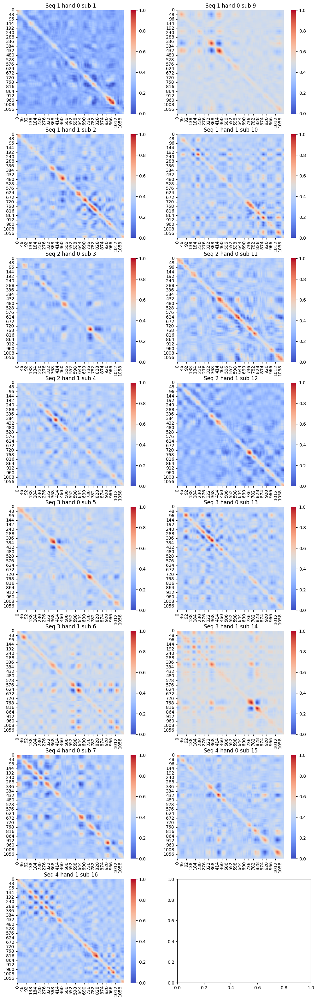

In [373]:
from scipy import signal

fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))
for idx, ((seqnum, hand, subnum), distances) in enumerate(tqdm(smoothed_distances_dict.items())):
    if subnum != 8:
        error_trials = all_error_trials[(seqnum, hand, subnum)]
        # sns.heatmap(distances, cmap = 'coolwarm', ax=axs[idx //2 , idx % 2])
        # signal.correlate2d(distances, filter, mode='valid')
        correlation = signal.correlate2d(distances, filter, mode='valid')
        # Normalize the correlation between 0 and 1
        correlation_min = correlation.min()
        correlation_max = correlation.max()

        normalized_correlation = (correlation - correlation_min) / (correlation_max - correlation_min)
        sns.heatmap(normalized_correlation, cmap = 'coolwarm', ax=axs[idx //2 , idx % 2])
        # for trial in error_trials:
        #     axs[idx//2, idx % 2].annotate('', xy = (0, trial), xytext = (-1, trial), arrowprops = dict(facecolor = 'green', shrink = 0.05, headwidth = 0.1))
        axs[idx//2, idx % 2].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
        # plt.show()    

Text(0, 0.5, 'Jump Distance')

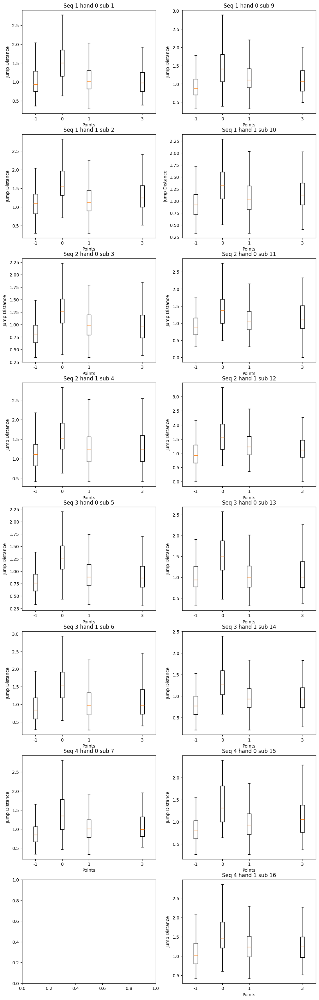

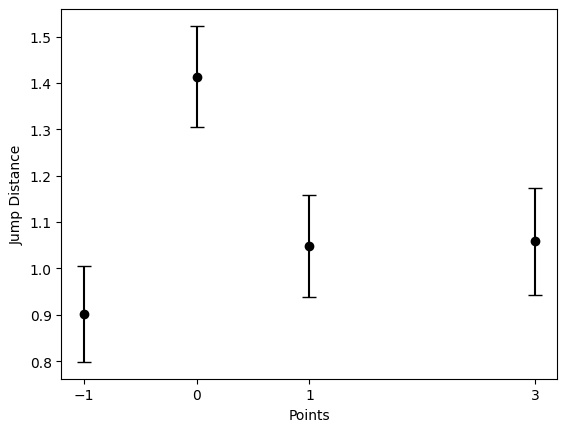

In [262]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

all_avg_distances = defaultdict(list)

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]

                #calculate euclidean distance between all consecutive trials
                distances = np.empty((forces.shape[0] - 1))
                for i in range(forces.shape[0] - 1):
                    distances[i] = np.linalg.norm(forces[i] - forces[i + 1])
                
                #drop duplicate trials based on N
                subdata = subdata.drop_duplicates(subset = 'N')
                #sort trials by 'N' and caculate trials points
                subdata = subdata.sort_values(by = 'N')

                trial_points = subdata['trialPoints'].to_numpy()[:n_trials_included-1]

                unique_points = np.unique(trial_points)
                avg_distances = []
                std_distances = []



                seq_ind = seqnum - 1
                ax_ind = (seq_ind * 2 + hand, subind)
                
                for point in unique_points:
                    axs[ax_ind].boxplot(distances[trial_points == point], positions = [point], showfliers = False)
                    all_avg_distances[point].append(np.median(distances[trial_points == point]))
                    # avg_distances.append(np.mean(distances[trial_points == point]))
                    # std_distances.append(np.std(distances[trial_points == point]))

                # axs[ax_ind].errorbar(unique_points, avg_distances, yerr = std_distances, fmt = 'o', color = 'black')

                axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
                axs[ax_ind].set_xlabel('Points')
                axs[ax_ind].set_ylabel('Jump Distance')
                # axs[ax_ind].legend()
plt.figure()
plt.errorbar(all_avg_distances.keys(), [np.mean(val) for val in all_avg_distances.values()], yerr = [np.std(val) for val in all_avg_distances.values()], fmt = 'o', color = 'black', 
             capsize = 5)
plt.xticks(list(all_avg_distances.keys()))
plt.xlabel('Points')
plt.ylabel('Jump Distance')

            

/var/folders/wg/16zn32014z5grhdv06dk49f00000gn/T/ipykernel_83159/4250311182.py:34: RuntimeWarning:

invalid value encountered in divide

/var/folders/wg/16zn32014z5grhdv06dk49f00000gn/T/ipykernel_83159/4250311182.py:34: RuntimeWarning:

invalid value encountered in divide

/var/folders/wg/16zn32014z5grhdv06dk49f00000gn/T/ipykernel_83159/4250311182.py:34: RuntimeWarning:

invalid value encountered in divide

/var/folders/wg/16zn32014z5grhdv06dk49f00000gn/T/ipykernel_83159/4250311182.py:34: RuntimeWarning:

invalid value encountered in divide

/var/folders/wg/16zn32014z5grhdv06dk49f00000gn/T/ipykernel_83159/4250311182.py:34: RuntimeWarning:

invalid value encountered in divide

/var/folders/wg/16zn32014z5grhdv06dk49f00000gn/T/ipykernel_83159/4250311182.py:34: RuntimeWarning:

invalid value encountered in divide

/var/folders/wg/16zn32014z5grhdv06dk49f00000gn/T/ipykernel_83159/4250311182.py:34: RuntimeWarning:

invalid value encountered in divide

/var/folders/wg/16zn32014z5grhdv06dk49f00

Text(0, 0.5, 'Jump on Innovation Direction')

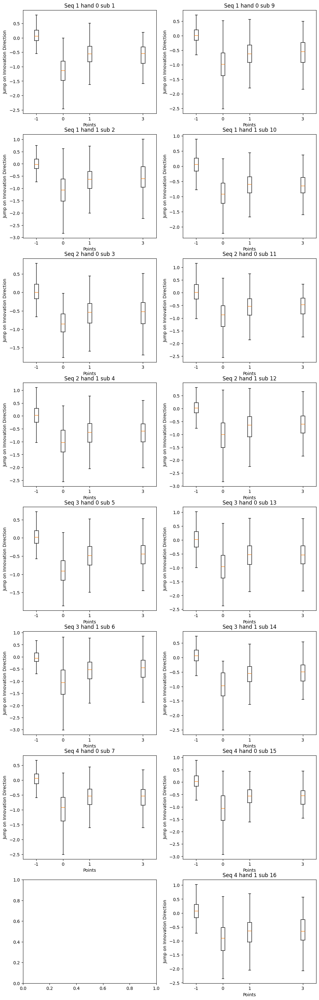

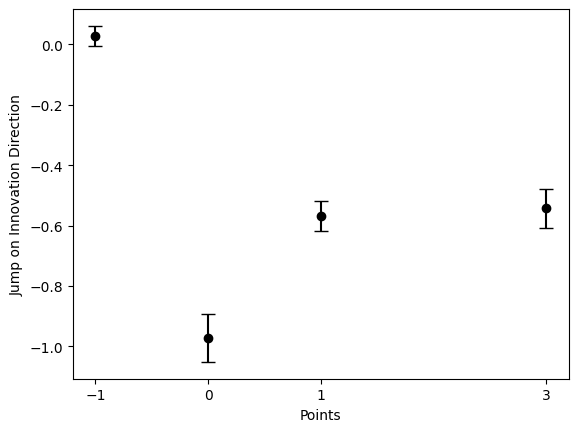

In [449]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

all_avg_projections = defaultdict(list)

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]
                forces_observed = reduced_forces_all_dict[(seqnum, hand, subnum)][:n_trials_included, :]

                #calculate smoothed difference vector between consecutive trials
                smoothed_diff = np.diff(forces, axis = 0)

                #calculate innovation vector
                innovations = (forces_observed - forces)[:-1]

                # project smoothed difference vector onto innovation vector
                projection = np.sum(smoothed_diff * innovations, axis = 1) / np.linalg.norm(innovations, axis = 1)
                # projection = np.sum(smoothed_diff * innovations, axis = 1) / np.linalg.norm(innovations, axis = 1) / np.linalg.norm(smoothed_diff, axis = 1)
                projection = np.nan_to_num(projection, copy = False) #todo: fix this
                
                #drop duplicate trials based on N
                subdata = subdata.drop_duplicates(subset = 'N')
                #sort trials by 'N' and caculate trials points
                subdata = subdata.sort_values(by = 'N')

                trial_points = subdata['trialPoints'].to_numpy()[:n_trials_included-1]

                unique_points = np.unique(trial_points)



                seq_ind = seqnum - 1
                ax_ind = (seq_ind * 2 + hand, subind)
                
                for point in unique_points:
                    axs[ax_ind].boxplot(projection[trial_points == point], positions = [point], showfliers = False)
                    all_avg_projections[point].append(np.median(projection[trial_points == point]))
                    # avg_distances.append(np.mean(distances[trial_points == point]))
                    # std_distances.append(np.std(distances[trial_points == point]))

                # axs[ax_ind].errorbar(unique_points, avg_distances, yerr = std_distances, fmt = 'o', color = 'black')

                axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
                axs[ax_ind].set_xlabel('Points')
                axs[ax_ind].set_ylabel('Jump on Innovation Direction')
                # axs[ax_ind].legend()
plt.figure()
plt.errorbar(all_avg_projections.keys(), [np.mean(val) for val in all_avg_projections.values()], yerr = [np.std(val) for val in all_avg_projections.values()], fmt = 'o', color = 'black', 
             capsize = 5)
plt.xticks(list(all_avg_projections.keys()))
plt.xlabel('Points')
plt.ylabel('Jump on Innovation Direction')

            

Text(0, 0.5, 'Jump Distance')

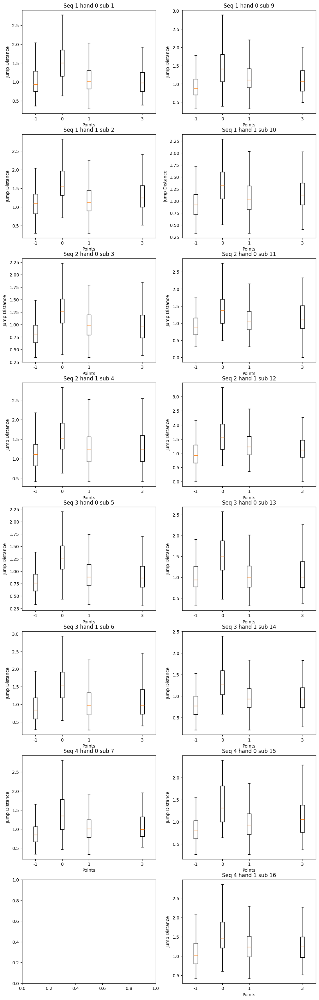

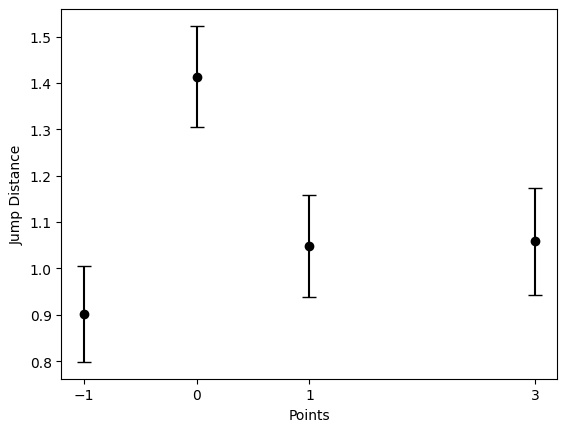

In [438]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

all_avg_distances = defaultdict(list)

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]
                original_forces = reduced_forces_all_dict[(seqnum, hand, subnum)][:n_trials_included, :]

                #calculate euclidean distance between all consecutive trials
                distances = np.empty((forces.shape[0] - 1))
                for i in range(forces.shape[0] - 1):
                    distances[i] = np.linalg.norm(forces[i] - forces[i + 1])
                
                #drop duplicate trials based on N
                subdata = subdata.drop_duplicates(subset = 'N')
                #sort trials by 'N' and caculate trials points
                subdata = subdata.sort_values(by = 'N')

                trial_points = subdata['trialPoints'].to_numpy()[:n_trials_included-1]

                unique_points = np.unique(trial_points)
                avg_distances = []
                std_distances = []



                seq_ind = seqnum - 1
                ax_ind = (seq_ind * 2 + hand, subind)
                
                for point in unique_points:
                    axs[ax_ind].boxplot(distances[trial_points == point], positions = [point], showfliers = False)
                    all_avg_distances[point].append(np.median(distances[trial_points == point]))
                    # avg_distances.append(np.mean(distances[trial_points == point]))
                    # std_distances.append(np.std(distances[trial_points == point]))

                # axs[ax_ind].errorbar(unique_points, avg_distances, yerr = std_distances, fmt = 'o', color = 'black')

                axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
                axs[ax_ind].set_xlabel('Points')
                axs[ax_ind].set_ylabel('Jump Distance')
                # axs[ax_ind].legend()
plt.figure()
plt.errorbar(all_avg_distances.keys(), [np.mean(val) for val in all_avg_distances.values()], yerr = [np.std(val) for val in all_avg_distances.values()], fmt = 'o', color = 'black', 
             capsize = 5)
plt.xticks(list(all_avg_distances.keys()))
plt.xlabel('Points')
plt.ylabel('Jump Distance')

            

In [278]:
print(trial_points[55:60])
trial_points[12]
x = forces[1:] - forces[:-1]
print(x[54:59])


[ 0 -1 -1  0  1]
[[ 0.28876463  1.10861126  0.23309778  0.74055225 -0.13209814 -0.4225248
  -0.48610727 -0.04311582  0.22577321 -0.29686292  0.39916523 -0.6145873
  -0.50897996 -0.34473984  0.08203908]
 [ 0.52678709 -0.60621711  0.22387423 -0.12617517 -0.47092229  0.06543028
  -0.19797224  0.32578729 -0.33273413  0.39011123 -0.13940624  0.21499708
   0.07276684  0.24623811 -0.12131752]
 [ 0.52678709 -0.60621711  0.22387423 -0.12617517 -0.47092229  0.06543028
  -0.19797224  0.32578729 -0.33273413  0.39011123 -0.13940624  0.21499708
   0.07276684  0.24623811 -0.12131752]
 [ 0.52678709 -0.60621711  0.22387423 -0.12617517 -0.47092229  0.06543028
  -0.19797224  0.32578729 -0.33273413  0.39011123 -0.13940624  0.21499708
   0.07276684  0.24623811 -0.12131752]
 [ 0.01372854 -0.37087607  0.39660567 -0.28862247  0.34205014 -0.09378009
   0.07766971  0.11458904  0.16996505 -0.41559487 -0.0026565  -0.10378606
   0.20181093  0.06164471  0.49216535]]


Text(0, 0.5, 'Frequency')

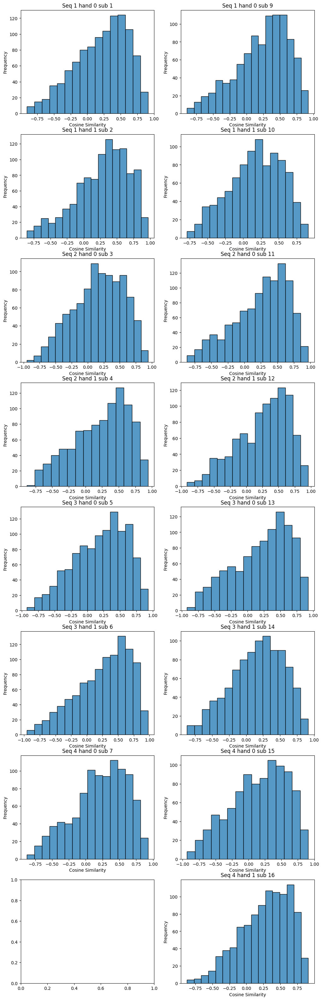

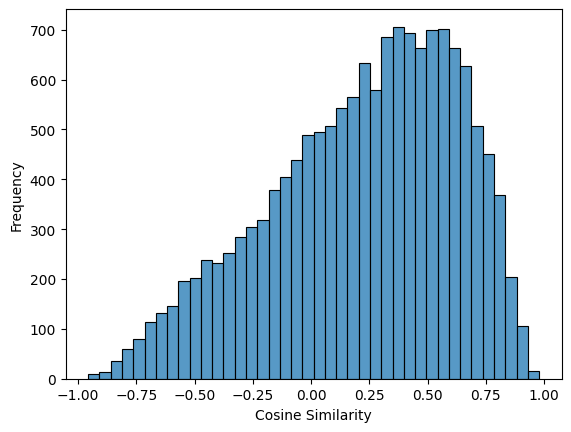

In [339]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

all_cos_sims = np.array([])

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]

                #calculate euclidean distance between all consecutive trials
                cos_sims = np.empty((forces.shape[0] - 2))
                for i in range(1, forces.shape[0] - 1):
                    first_jump = forces[i] - forces[i - 1]
                    second_jump = forces[i + 1] - forces[i]
                    if (np.linalg.norm(first_jump) * np.linalg.norm(second_jump)) != 0:
                        cos_sims[i-1] = np.dot(first_jump, second_jump) / (np.linalg.norm(first_jump) * np.linalg.norm(second_jump))
                
                #drop duplicate trials based on N
                subdata = subdata.drop_duplicates(subset = 'N')
                #sort trials by 'N' and caculate trials points
                subdata = subdata.sort_values(by = 'N')

                trial_points = subdata['trialPoints'].to_numpy()[1:n_trials_included-1]

                unique_points = np.unique(trial_points)
                cos_sims = cos_sims[trial_points != -1]
                all_cos_sims = np.append(all_cos_sims, cos_sims)


                seq_ind = seqnum - 1
                ax_ind = (seq_ind * 2 + hand, subind)
                sns.histplot(cos_sims, ax = axs[ax_ind])


                axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
                axs[ax_ind].set_xlabel('Cosine Similarity')
                axs[ax_ind].set_ylabel('Frequency')

plt.figure()
sns.histplot(all_cos_sims)
plt.xlabel('Cosine Similarity')
plt.ylabel('Frequency')


            

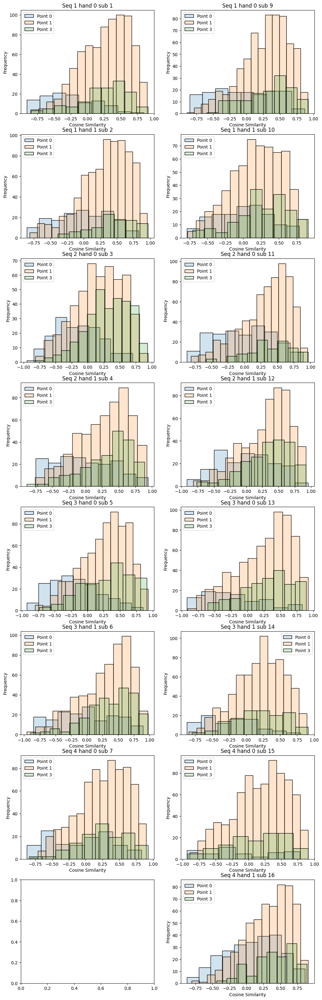

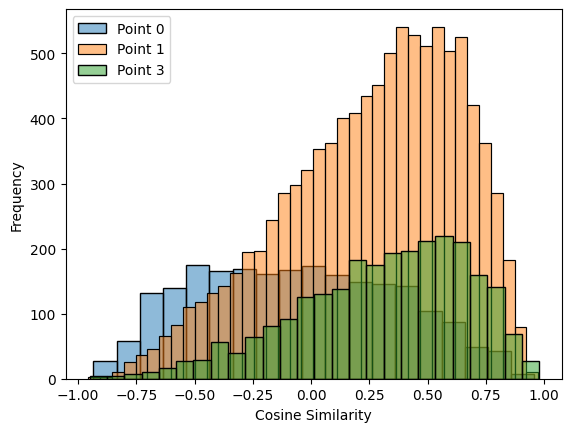

In [351]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

all_cos_sims = defaultdict(list)

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]

                #calculate euclidean distance between all consecutive trials
                cos_sims = np.empty((forces.shape[0] - 2))
                for i in range(1, forces.shape[0] - 1):
                    first_jump = forces[i] - forces[i - 1]
                    second_jump = forces[i + 1] - forces[i]
                    if (np.linalg.norm(first_jump) * np.linalg.norm(second_jump)) != 0:
                        cos_sims[i-1] = np.dot(first_jump, second_jump) / (np.linalg.norm(first_jump) * np.linalg.norm(second_jump))
                
                #drop duplicate trials based on N
                subdata = subdata.drop_duplicates(subset = 'N')
                #sort trials by 'N' and caculate trials points
                subdata = subdata.sort_values(by = 'N')

                trial_points = subdata['trialPoints'].to_numpy()[1:n_trials_included-1]

                unique_points = np.unique(trial_points)


                seq_ind = seqnum - 1
                ax_ind = (seq_ind * 2 + hand, subind)

                for point in unique_points:
                    if point != -1:
                        all_cos_sims[point].extend(cos_sims[trial_points == point])
                        sns.histplot(cos_sims[trial_points == point], 
                                     alpha = 0.2 ,label = f'Point {point}', ax = axs[ax_ind])


                axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
                axs[ax_ind].set_xlabel('Cosine Similarity')
                axs[ax_ind].set_ylabel('Frequency')
                axs[ax_ind].legend()

plt.figure()
for point, cos_sims in all_cos_sims.items():
    sns.histplot(cos_sims, alpha = 0.5, label = f'Point {point}')
plt.xlabel('Cosine Similarity')
plt.ylabel('Frequency')
plt.legend()


            

Text(0, 0.5, 'Jump Similarity (Cosine)')

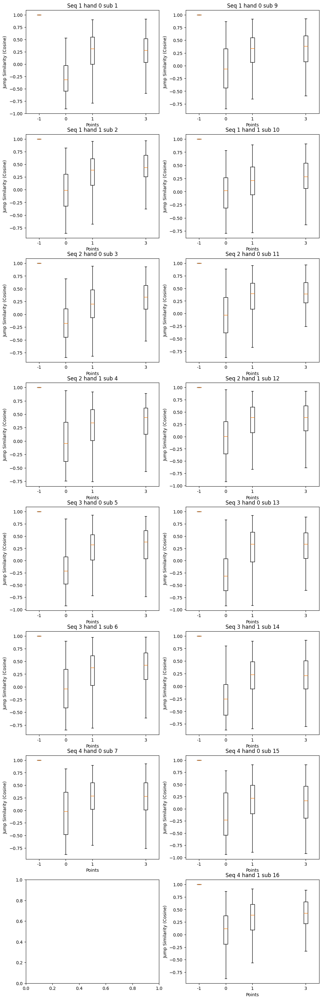

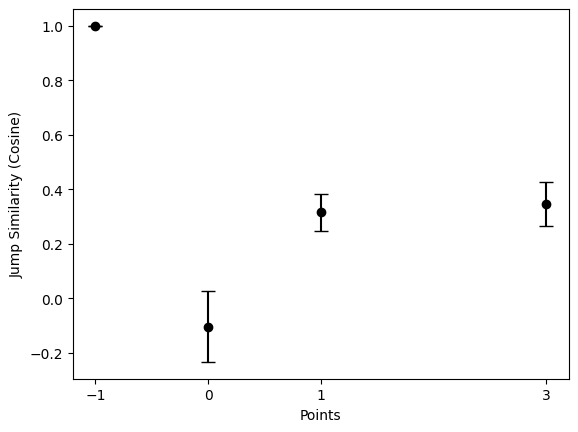

In [295]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict

fig, axs = plt.subplots(4*2, 2, figsize = (12, 40))

num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

all_avg_cos_sims = defaultdict(list)

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]

                #calculate euclidean distance between all consecutive trials
                cos_sims = np.empty((forces.shape[0] - 2))
                for i in range(1, forces.shape[0] - 1):
                    first_jump = forces[i] - forces[i - 1]
                    second_jump = forces[i + 1] - forces[i]
                    if (np.linalg.norm(first_jump) * np.linalg.norm(second_jump)) != 0:
                        cos_sims[i-1] = np.dot(first_jump, second_jump) / (np.linalg.norm(first_jump) * np.linalg.norm(second_jump))
                
                #drop duplicate trials based on N
                subdata = subdata.drop_duplicates(subset = 'N')
                #sort trials by 'N' and caculate trials points
                subdata = subdata.sort_values(by = 'N')

                trial_points = subdata['trialPoints'].to_numpy()[1:n_trials_included-1]

                unique_points = np.unique(trial_points)
                avg_distances = []
                std_distances = []



                seq_ind = seqnum - 1
                ax_ind = (seq_ind * 2 + hand, subind)
                
                for point in unique_points:
                    # if point != -1:
                    
                        axs[ax_ind].boxplot(cos_sims[trial_points == point], positions = [point], showfliers = False)
                        all_avg_cos_sims[point].append(np.median(cos_sims[trial_points == point]))
                        # avg_distances.append(np.mean(distances[trial_points == point]))
                        # std_distances.append(np.std(distances[trial_points == point]))

                # axs[ax_ind].errorbar(unique_points, avg_distances, yerr = std_distances, fmt = 'o', color = 'black')

                axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
                axs[ax_ind].set_xlabel('Points')
                axs[ax_ind].set_ylabel('Jump Similarity (Cosine)')
                # axs[ax_ind].legend()
plt.figure()
plt.errorbar(all_avg_cos_sims.keys(), [np.mean(val) for val in all_avg_cos_sims.values()], yerr = [np.std(val) for val in all_avg_cos_sims.values()], fmt = 'o', color = 'black', 
             capsize = 5)
plt.xticks(list(all_avg_cos_sims.keys()))
plt.xlabel('Points')
plt.ylabel('Jump Similarity (Cosine)')

            

In [296]:
from sklearn.decomposition import PCA
forces = [1,2,3,4,5]
import pickle
from collections import defaultdict


num_sequences = 4
num_cores = mp.cpu_count()
cmap = cm.Pastel1
n_trials_included = 1200

# num_trials = 1200

all_avg_cos_sims = defaultdict(list)

seq_types = subjs['seqType'].unique()

for seqnum, seq_data in subjs.groupby('seqType'):
    for hand, hand_data in seq_data.groupby('board'):
        for subind, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            if subnum != 8:

                forces = reduced_forces_all_smoothed[(seqnum, hand, subnum)][:n_trials_included, :]
                forces_original = reduced_forces_all_dict[(seqnum, hand, subnum)][:n_trials_included, :]

                #calculate euclidean distance between all consecutive trials
                cos_sims = np.empty((forces.shape[0] - 2))
                for i in range(1, forces.shape[0] - 1):
                    first_jump = forces[i] - forces[i - 1]
                    second_jump = forces[i + 1] - forces[i]
                    first_jump_original = forces_original[i] - forces_original[i - 1]
                    second_jump_original = forces_original[i + 1] - forces_original[i]
                    if (np.linalg.norm(first_jump) * np.linalg.norm(second_jump)) == 0:
                        print(i)
                        print(first_jump)
                        print(second_jump)
                        print(first_jump_original)
                        print(second_jump_original)
                    cos_sims[i-1] = np.dot(first_jump, second_jump) / (np.linalg.norm(first_jump) * np.linalg.norm(second_jump))
                
                #drop duplicate trials based on N
                subdata = subdata.drop_duplicates(subset = 'N')
                #sort trials by 'N' and caculate trials points
                subdata = subdata.sort_values(by = 'N')

                trial_points = subdata['trialPoints'].to_numpy()[1:n_trials_included-1]

                unique_points = np.unique(trial_points)
                avg_distances = []
                std_distances = []



                seq_ind = seqnum - 1
                ax_ind = (seq_ind * 2 + hand, subind)
                
                for point in unique_points:
                    # if point != -1:
                        all_avg_cos_sims[point].append(np.median(cos_sims[trial_points == point]))
                        # avg_distances.append(np.mean(distances[trial_points == point]))
                        # std_distances.append(np.std(distances[trial_points == point]))


            

1197
[-0.48278029  0.0114487   0.18093784  0.03958435 -0.03997422  0.32781651
  0.3368239  -0.54600147 -0.18117719 -0.09630592 -0.21967629  0.37499622
 -0.06772661 -0.22039713  0.13110369]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[-1.51749143  2.05153974  0.4446732   0.270546   -0.47052309  0.66263017
  0.64686136 -1.60439232 -0.91413731 -0.02159963 -0.09070115  1.15834132
 -0.2330864  -1.07043978  0.33937603]
[ 5.98954915  3.91761641  1.22218609  1.30975654  0.5041449  -3.87473021
 -1.57717919  2.82772941  0.60983447  3.08421693  1.59570666  1.60472388
 -0.22469167  1.88326985 -1.07802018]
1198
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
[ 5.98954915  3.91761641  1.22218609  1.30975654  0.5041449  -3.87473021
 -1.57717919  2.82772941  0.60983447  3.08421693  1.59570666  1.60472388
 -0.22469167  1.88326985 -1.07802018]
[ 3.58309837  0.17001083 -4.86931301  3.106464    0.75158262  0.34469448
  1.29631007 -0.79963457 -3.1727293  -4.

/var/folders/wg/16zn32014z5grhdv06dk49f00000gn/T/ipykernel_83159/4108903593.py:39: RuntimeWarning:

invalid value encountered in scalar divide



In [50]:
kf.transition_matrices.diagonal()

array([0.88879165, 0.67436469, 0.70570085, 0.73545267, 0.70166987,
       0.70438351, 0.58648976, 0.63771737, 0.59255934, 0.53957807,
       0.45998463, 0.56674955, 0.438806  , 0.52295608, 0.28470695])

In [52]:
np.sum(kf.transition_matrices, axis = 1)

array([ 0.94182225, -0.18334355,  0.37355619,  0.70794244,  0.67559483,
        0.69241627,  1.01356863,  0.92418856,  0.87093353,  0.76097605,
        0.53130728,  0.71797249,  0.38923733,  0.54765413,  0.14218465])

In [54]:
kf.observation_matrices.diagonal()

array([1.11676064, 1.32574749, 1.25727347, 1.0591293 , 1.0044523 ,
       0.91264139, 0.93108137, 0.86696765, 0.75149779, 0.75489903,
       0.69164769, 0.6253618 , 0.6015516 , 0.53160816, 0.44956645])

In [55]:
np.sum(kf.observation_matrices, axis = 1)

array([1.62713346, 1.84384959, 1.6531509 , 1.09975832, 0.9519066 ,
       0.83365704, 0.83245299, 0.73830263, 0.72710805, 0.79300024,
       0.72308782, 0.54653056, 0.57498961, 0.54653168, 0.39104644])

In [106]:
kf.transition_offsets

array([-0.00296403, -0.00633053,  0.00474771,  0.00072071,  0.00148572,
       -0.00258348,  0.00223258,  0.0031309 ,  0.00147239, -0.00265575,
        0.00310905,  0.00023788,  0.00093283, -0.00359448, -0.00389597])

In [110]:
#project and plot random walk on the first 3 principal components interactively in 3D
import plotly.graph_objects as go
from pykalman import KalmanFilter


for idx, ((seqnum, hand, subnum), forces) in enumerate(reduced_forces_correct_dict.items()):
    kf = KalmanFilter(n_dim_state = n_dim_reduction, n_dim_obs = n_dim_reduction, observation_matrices = np.eye(n_dim_reduction), 
                transition_offsets = np.zeros(n_dim_reduction), observation_offsets = np.zeros(n_dim_reduction), initial_state_mean=forces[0], 
                initial_state_covariance=np.zeros((n_dim_reduction, n_dim_reduction)),
                em_vars=['transition_covariance', 'observation_covariance', 'transition_matrices', 'observation_matrices', 'transition_offsets'])
    kf = kf.em(forces, n_iter=5)
    smoothed_states, _ = kf.smooth(forces)

    #change color of lines continuously with index
    color = np.arange(len(forces))
    fig = go.Figure(data=[go.Scatter3d(x=smoothed_states[:,0], y=smoothed_states[:,1], z=smoothed_states[:,2], mode='lines', line=dict(color=color, colorscale='Viridis', width=1, showscale = True))])
    #show color progression in colorbar
    # fig.update_layout(coloraxis_colorbar=dict(title='Index', tickvals=[0, len(forces)], ticktext=['Start', 'End']))

    # fig = go.Figure(data=[go.Scatter3d(x=forces[:,0], y=forces[:,1], z=forces[:,2], mode='lines')])
    fig.update_layout(scene = dict(
                        xaxis_title='PC1',
                        yaxis_title='PC2',
                        zaxis_title='PC3'), 
                        width=800,
                        height=800, 
                        margin=dict(l=100, r=100, b = 100, t=100),
                        title_text = f'Seq {seqnum} hand {hand} sub {subnum}')
                        
    fig.show()




In [58]:
aligned_cut_force['trialPoints'].unique()

array([ 0,  1,  3, -1])

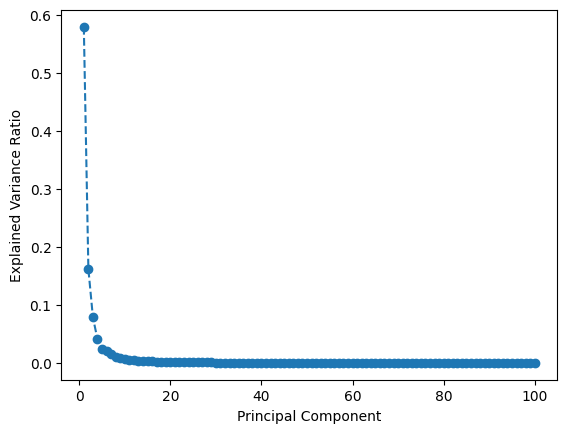

In [143]:
from sklearn.decomposition import PCA

# random_steps = np.random.normal(0,0.1, size = (1000, len(fingers) * (n_samples_left_right * 2 + n_samples)))
random_steps = np.random.normal(0,0.1, size = (1000, 100))

random_walk = np.cumsum(random_steps, axis = 0)
pca = PCA()
pca.fit(random_walk)
explained_variance = pca.explained_variance_ratio_
plt.plot(np.arange(1, len(explained_variance) + 1), explained_variance, marker = 'o', linestyle = '--')
# plt.ylim([0,1])
# plt.yscale('log')
# plt.ylim([1e-3, 1])
plt.ylabel('Explained Variance Ratio')
plt.xlabel('Principal Component')
plt.show()



<Axes: >

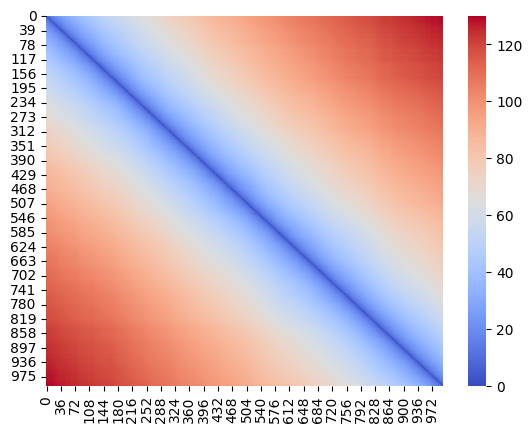

In [128]:
#euclidean distance of all pairs in random_walk by matrix operations
random_walk_T = random_walk.T
distances = np.sqrt(np.sum((random_walk_T[:, :, None] - random_walk_T[:, None, :]) ** 2, axis = 0))
sns.heatmap(distances, cmap = 'coolwarm')

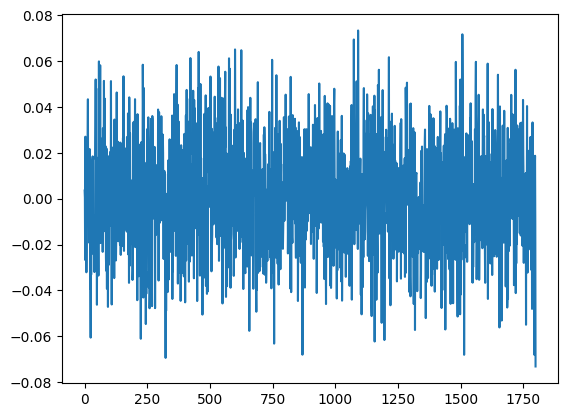

In [129]:
plt.plot(pca.components_[0])

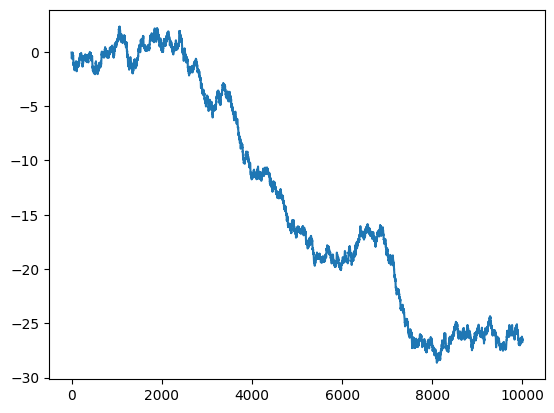

In [139]:
#projecting the random walk on the first principal component
projection = random_walk @ pca.components_[0]
#plotting the projection
plt.plot(projection)



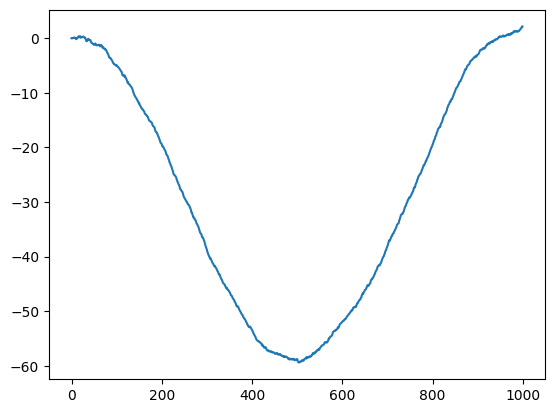

In [132]:
#projecting the random walk on the first principal component
projection = random_walk @ pca.components_[1]
#plotting the projection
plt.plot(projection)



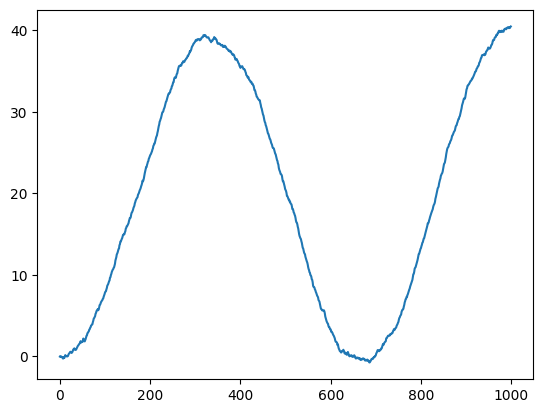

In [134]:
#projecting the random walk on the first principal component
projection = random_walk @ pca.components_[2]
#plotting the projection
plt.plot(projection)



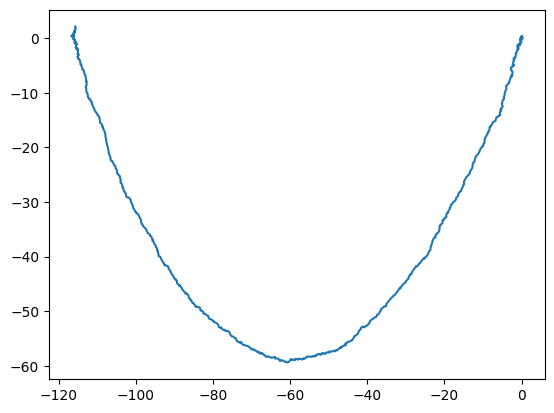

In [131]:
#project and plot random walk on the first 2 principal components
projection = random_walk @ pca.components_[:2].T
plt.plot(projection[:,0], projection[:,1])

In [133]:
#project and plot random walk on the first 3 principal components interactively in 3D
import plotly.graph_objects as go

projection = random_walk @ pca.components_[:3].T

fig = go.Figure(data=[go.Scatter3d(x=projection[:,0], y=projection[:,1], z=projection[:,2], mode='lines')])
fig.update_scenes(aspectmode='cube')
fig.update_layout(scene = dict(
                    xaxis_title='PC1',
                    yaxis_title='PC2',
                    zaxis_title='PC3'), 
                    width=800,
                    height=800, 
                    margin=dict(l=100, r=100, b = 100, t=100))
fig.show()



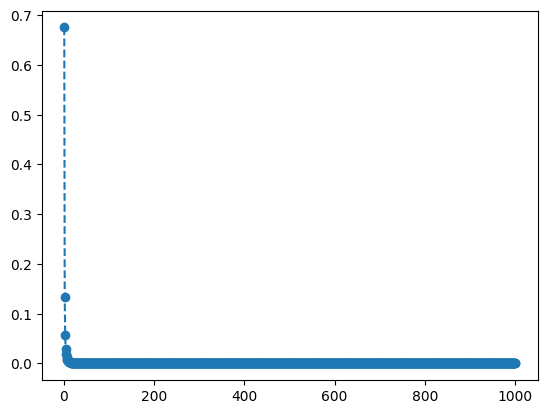

In [23]:
decay_factor = 0.99
random_steps = np.random.normal(0,0.1, size = (1000, len(fingers) * (n_samples_left_right * 2 + n_samples)))
decay = decay_factor ** np.arange(1000)[:, np.newaxis]
random_steps *= decay
random_walk = np.cumsum(random_steps, axis = 0)
pca = PCA()
pca.fit(random_walk)
explained_variance = pca.explained_variance_ratio_
plt.plot(np.arange(1, len(explained_variance) + 1), explained_variance, marker = 'o', linestyle = '--')
# plt.yscale('log')
# plt.ylim([1e-3, 1])
plt.show()


<Axes: >

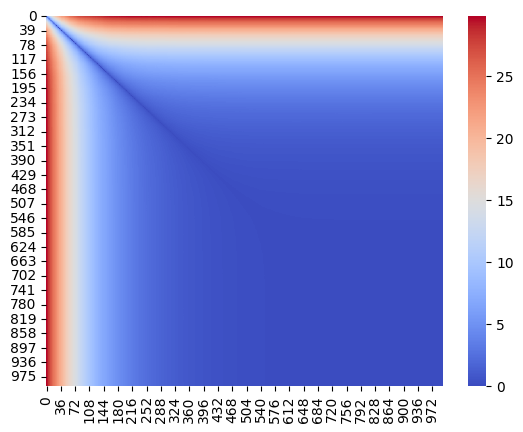

In [24]:
#euclidean distance of all pairs in random_walk by matrix operations
random_walk_T = random_walk.T
distances = np.sqrt(np.sum((random_walk_T[:, :, None] - random_walk_T[:, None, :]) ** 2, axis = 0))
sns.heatmap(distances, cmap = 'coolwarm')

In [44]:
from sklearn.decomposition import PCA


decay_factors = [0.99]
for decay_factor in decay_factors:
    # random_steps = np.random.normal(0,0.1, size = (1000, len(fingers) * (n_samples_left_right * 2 + n_samples)))
    random_steps = np.random.normal(0,0.1, size = (1000, 50))

    random_walk = np.empty_like(random_steps)
    random_walk[0] = random_steps[0]
    for i in range(1, len(random_steps)):
        random_walk[i] = decay_factor * random_walk[i-1] + random_steps[i]

    pca = PCA()
    pca.fit(random_walk)
    explained_variance = pca.explained_variance_ratio_
    plt.figure()
    plt.plot(np.arange(1, len(explained_variance) + 1), explained_variance, marker = 'o', linestyle = '--')
    plt.title(f'Decay Factor: {decay_factor}')
    # plt.yscale('log')
    # plt.ylim([1e-3, 1])
    #euclidean distance of all pairs in random_walk by matrix operations
    random_walk_T = random_walk.T
    distances = np.sqrt(np.sum((random_walk_T[:, :, None] - random_walk_T[:, None, :]) ** 2, axis = 0))
    plt.figure()
    sns.heatmap(distances, cmap = 'coolwarm')
plt.show()

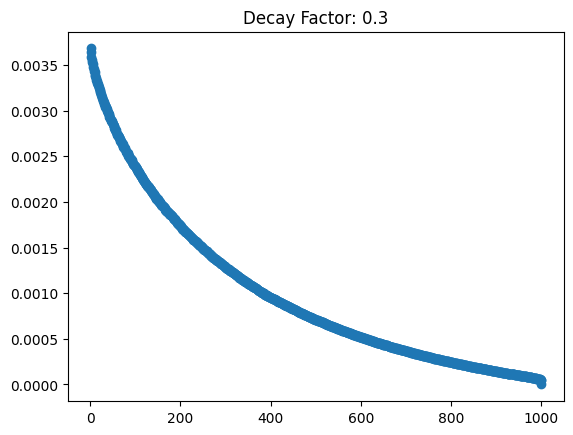

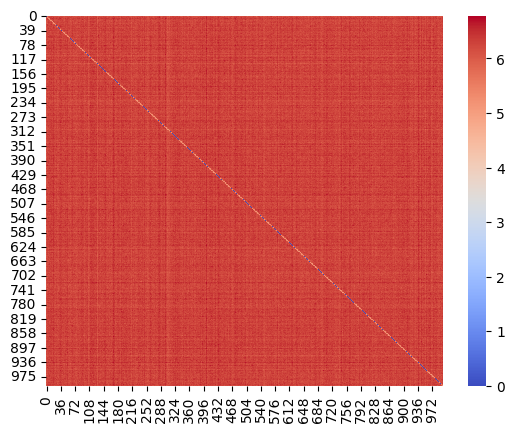

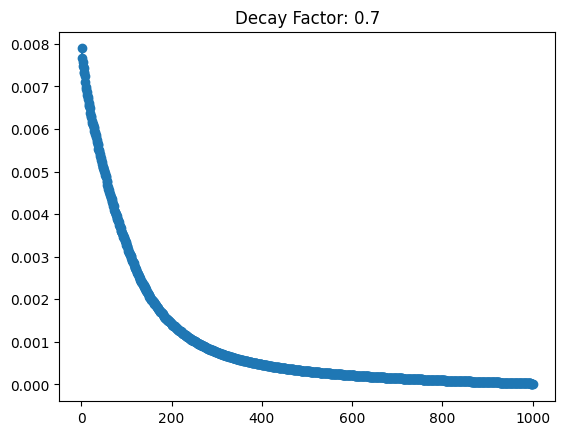

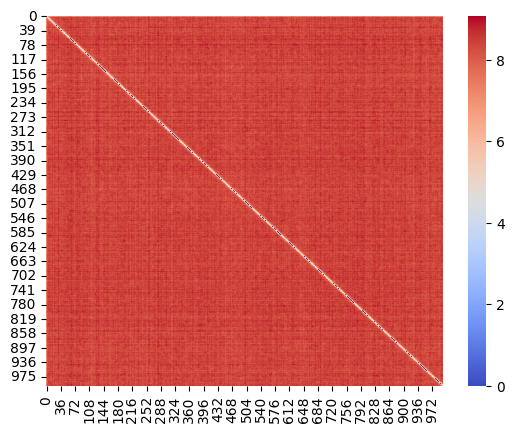

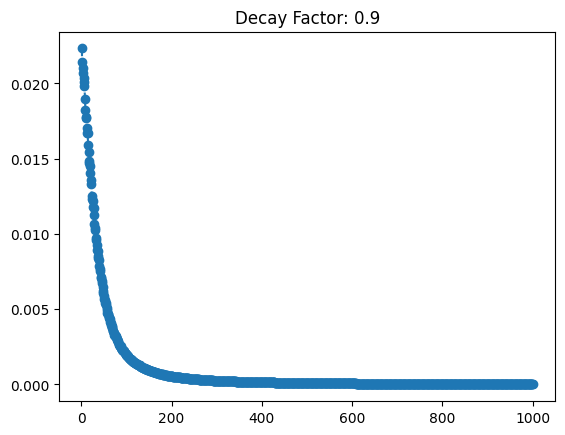

...

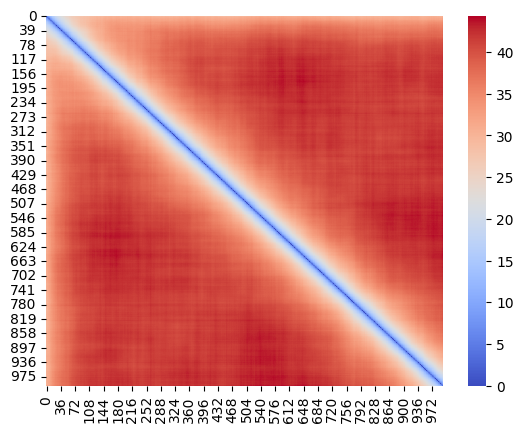

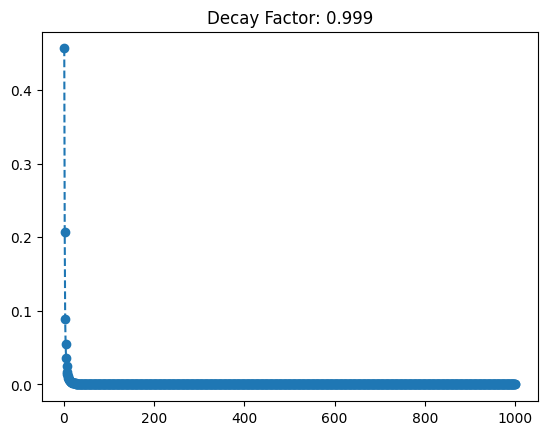

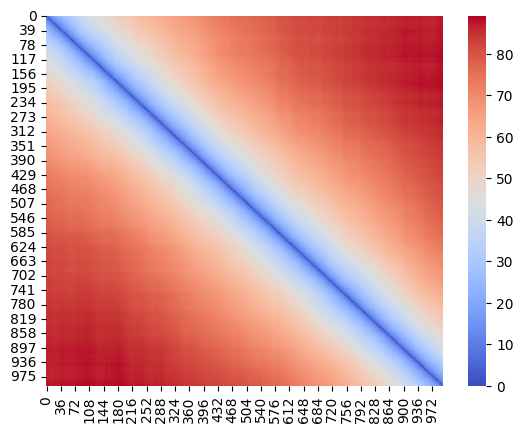

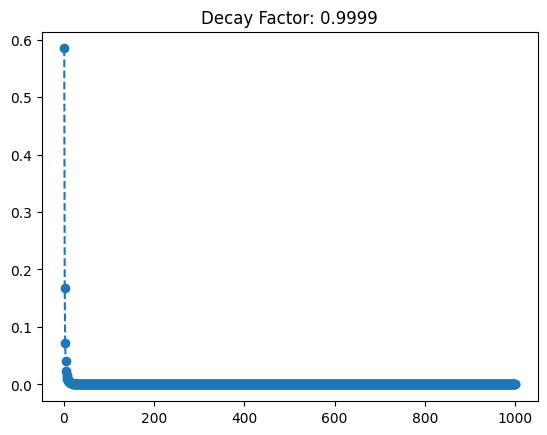

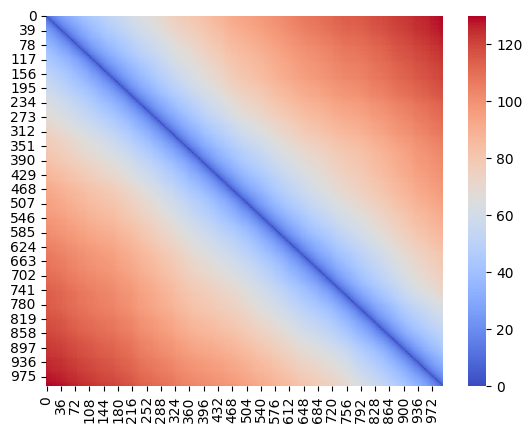

In [142]:
decay_factors = [0.3, 0.7, 0.9, 0.99, 0.999, 0.9999]
for decay_factor in decay_factors:
    random_steps = np.random.normal(0,0.1, size = (1000, len(fingers) * (n_samples_left_right * 2 + n_samples)))
    random_walk = np.empty_like(random_steps)
    random_walk[0] = random_steps[0]
    for i in range(1, len(random_steps)):
        random_walk[i] = decay_factor * random_walk[i-1] + random_steps[i]

    pca = PCA()
    pca.fit(random_walk)
    explained_variance = pca.explained_variance_ratio_
    plt.figure()
    plt.plot(np.arange(1, len(explained_variance) + 1), explained_variance, marker = 'o', linestyle = '--')
    plt.title(f'Decay Factor: {decay_factor}')
    # plt.yscale('log')
    # plt.ylim([1e-3, 1])
    #euclidean distance of all pairs in random_walk by matrix operations
    random_walk_T = random_walk.T
    distances = np.sqrt(np.sum((random_walk_T[:, :, None] - random_walk_T[:, None, :]) ** 2, axis = 0))
    plt.figure()
    sns.heatmap(distances, cmap = 'coolwarm')
plt.show()

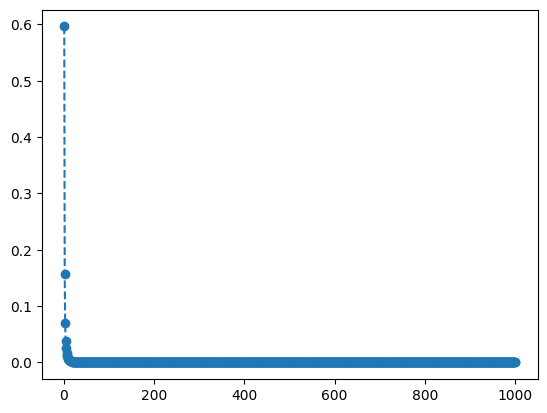

In [141]:
cov = np.random.random(len(fingers) * (n_samples_left_right * 2 + n_samples))
# cov = np.ones(len(fingers) * (n_samples_left_right * 2 + n_samples)) * 0.01
# cov[0] = 0.8
random_steps = np.random.multivariate_normal(np.zeros(len(fingers) * (n_samples_left_right * 2 + n_samples)), np.diag(cov), size = 1000)
random_walk = np.cumsum(random_steps, axis = 0)
pca = PCA()
pca.fit(random_walk)
explained_variance = pca.explained_variance_ratio_
plt.plot(np.arange(1, len(explained_variance) + 1), explained_variance, marker = 'o', linestyle = '--')
# plt.ylim([0,1])
# plt.yscale('log')
# plt.ylim([1e-3, 1])
plt.show()

<Axes: >

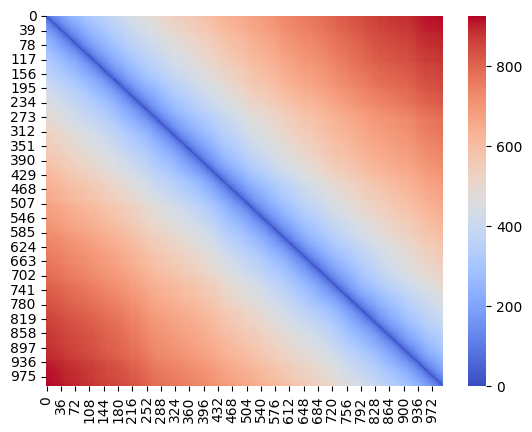

In [1131]:
#euclidean distance of all pairs in random_walk by matrix operations
random_walk_T = random_walk.T
distances = np.sqrt(np.sum((random_walk_T[:, :, None] - random_walk_T[:, None, :]) ** 2, axis = 0))
sns.heatmap(distances, cmap = 'coolwarm')

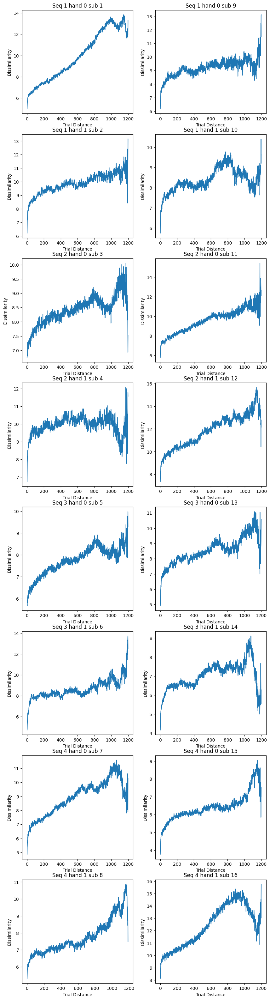

In [169]:
from collections import defaultdict
fig , axs = plt.subplots(4 * 2, 2, figsize = (10, 40))
for idx, ((seqnum, hand, subnum), distances) in enumerate(distances_dict.items()):
    similarities_distance_dict = defaultdict(list)
    for index, row in distances.iterrows():
        for col in distances.columns:
            if col > index:
                similarities_distance_dict[col - index].append(row[col])
    x = np.sort(list(similarities_distance_dict.keys()))
    y  = [np.median(similarities_distance_dict[key]) for key in x]
    # yerr = [np.std(similarities_distance_dict[key]) / np.sqrt(len(similarities_distance_dict[key])) for key in x]

    ax_ind = (idx // 2, idx % 2)

    # axs[ax_ind].errorbar(x, y, yerr = yerr)
    axs[ax_ind].plot(x, y)
    axs[ax_ind].set_xlabel('Trial Distance')
    axs[ax_ind].set_ylabel('Dissimilarity')

    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

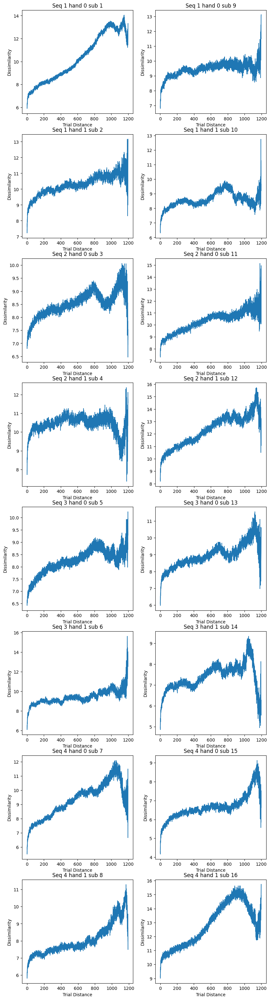

In [170]:
from collections import defaultdict
fig , axs = plt.subplots(4 * 2, 2, figsize = (10, 40))
for idx, ((seqnum, hand, subnum), distances) in enumerate(distances_dict.items()):
    similarities_distance_dict = defaultdict(list)
    for index, row in distances.iterrows():
        for col in distances.columns:
            if col > index:
                similarities_distance_dict[col - index].append(row[col])
    x = np.sort(list(similarities_distance_dict.keys()))
    y  = [np.mean(similarities_distance_dict[key]) for key in x]
    yerr = [np.std(similarities_distance_dict[key]) / np.sqrt(len(similarities_distance_dict[key])) for key in x]

    ax_ind = (idx // 2, idx % 2)

    axs[ax_ind].errorbar(x, y, yerr = yerr)
    axs[ax_ind].set_xlabel('Trial Distance')
    axs[ax_ind].set_ylabel('Dissimilarity')

    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

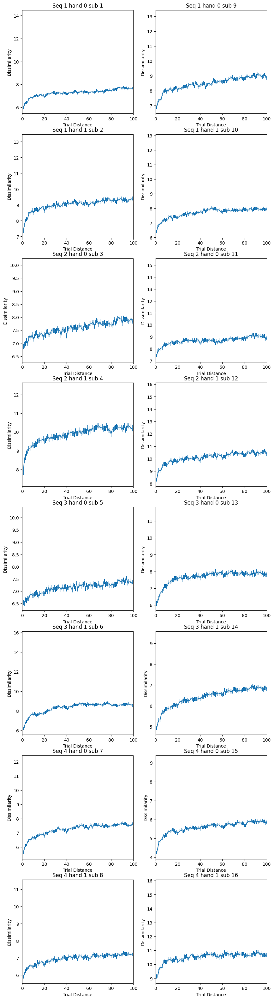

In [171]:
from collections import defaultdict
fig , axs = plt.subplots(4 * 2, 2, figsize = (10, 40))
for idx, ((seqnum, hand, subnum), distances) in enumerate(distances_dict.items()):
    similarities_distance_dict = defaultdict(list)
    for index, row in distances.iterrows():
        for col in distances.columns:
            if col > index:
                similarities_distance_dict[col - index].append(row[col])
    x = np.sort(list(similarities_distance_dict.keys()))
    y  = [np.mean(similarities_distance_dict[key]) for key in x]
    yerr = [np.std(similarities_distance_dict[key]) / np.sqrt(len(similarities_distance_dict[key])) for key in x]

    ax_ind = (idx // 2, idx % 2)

    axs[ax_ind].errorbar(x, y, yerr = yerr)
    axs[ax_ind].set_xlabel('Trial Distance')
    axs[ax_ind].set_ylabel('Dissimilarity')
    axs[ax_ind].set_xlim([0, 100])

    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

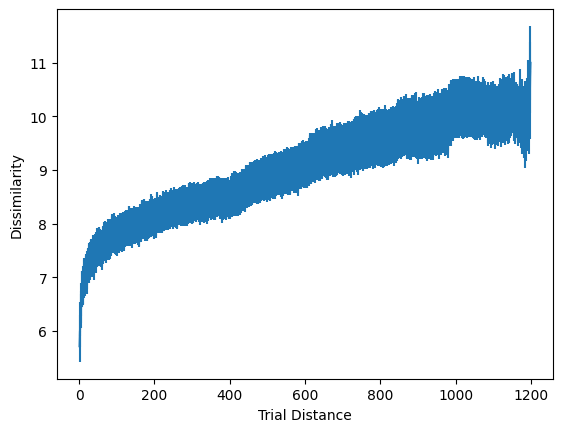

In [172]:
from collections import defaultdict
similarities_distances = []
for idx, ((seqnum, hand, subnum), distances) in enumerate(distances_dict.items()):
    for index, row in distances.iterrows():
        for col in distances.columns:
            if col > index:
                # similarities_distance_dict[col - index].append(row[col])
                similarities_distances.append({'seqnum': seqnum, 'hand': hand, 'SubNum': subnum, 'trial_distance': col - index, 'dissimilarity': row[col]})

similarities_distances = pd.DataFrame(similarities_distances)

similarities_distances.groupby(['SubNum']).agg({'dissimilarity': 'median'})

similarity_dist_agg = similarities_distances.groupby(['SubNum', 'trial_distance']).agg({'dissimilarity': 'median'}).reset_index()

similarity_dist_agg = similarity_dist_agg.groupby('trial_distance').agg({'dissimilarity': ['mean', 'std']}).reset_index()

plt.errorbar(similarity_dist_agg['trial_distance'], similarity_dist_agg['dissimilarity']['mean'], yerr = similarity_dist_agg['dissimilarity']['std']/np.sqrt(16))
plt.xlabel('Trial Distance')
plt.ylabel('Dissimilarity')

plt.show()


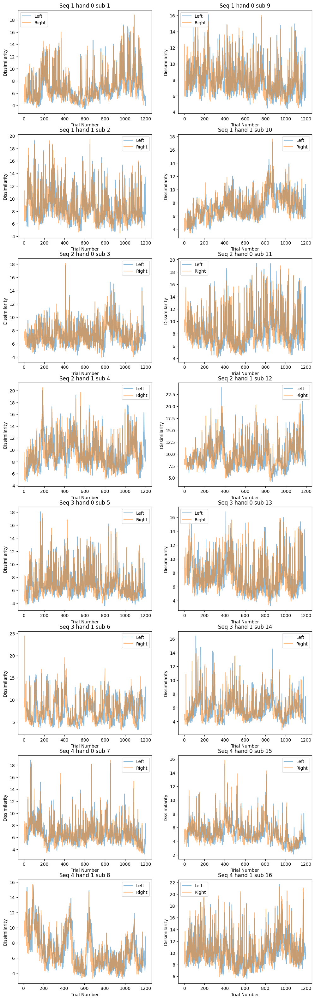

In [173]:

fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))
# smoothed_corrs = np.zeros(all_corrs_corr.shape[:-1])
smoothing_window = 20
window = np.ones((smoothing_window,))
window = window / window.sum()
# window[smoothing_window // 2] = 0
# window = window / window.sum()


for idx, ((seqnum, hand, subnum), distances) in enumerate(distances_dict.items()):
    smoothed_distances_left = {}
    smoothed_distances_right = {}
    for trial_idx, (index, row) in enumerate(distances.iterrows()):
        if trial_idx >= smoothing_window:
            smoothed_distances_left[index] = np.mean(row.iloc[trial_idx - smoothing_window: trial_idx])
        if trial_idx < len(distances) - smoothing_window:
            smoothed_distances_right[index] = np.mean(row.iloc[trial_idx + 1: trial_idx + smoothing_window + 1])


    ax_ind = (idx // 2, idx % 2)
    axs[ax_ind].plot(list(smoothed_distances_left.keys()), list(smoothed_distances_left.values()), label = 'Left', alpha = 0.5)
    axs[ax_ind].plot(list(smoothed_distances_right.keys()), list(smoothed_distances_right.values()), label = 'Right', alpha = 0.5)
    error_trials = all_error_trials[(seqnum, hand, subnum)]
    # for trial in error_trials:
    #     axs[ax_ind].axvline(trial, color = 'red', linestyle = '--', alpha = 0.1)

    axs[ax_ind].set_xlabel('Trial Number')
    axs[ax_ind].set_ylabel('Dissimilarity')
    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    axs[ax_ind].legend()


# for seq in range(4):
#     for hand in range(2):
#         for subnum in range(total_sub_num//(4*2)):
#             for trial in range(num_trials):
#                 smoothed_corrs[seq, hand, subnum, trial] = np.convolve(all_corrs_corr[seq, hand, subnum, trial], window, mode='same')[trial]
#             subplot_idx = (seq *2 + hand, subnum)
#             axs[subplot_idx].scatter(all_error_trials[seq, hand, subnum], smoothed_corrs[seq, hand, subnum][all_error_trials[seq, hand, subnum]], color = 'red')
#             axs[subplot_idx].plot(smoothed_corrs[seq, hand, subnum])
#             axs[subplot_idx].set_ylim([0,1])

#             axs[subplot_idx].set_title(f'Seq {seq} hand {hand} Sub {subnum}')

                


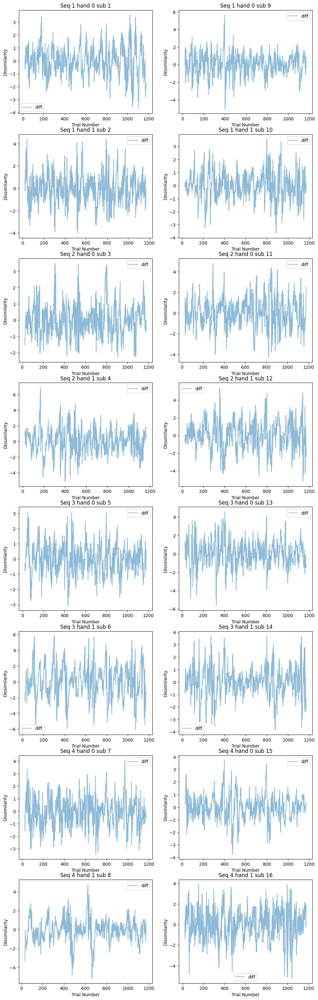

In [174]:

fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))
# smoothed_corrs = np.zeros(all_corrs_corr.shape[:-1])
smoothing_window = 20
window = np.ones((smoothing_window,))
window = window / window.sum()
# window[smoothing_window // 2] = 0
# window = window / window.sum()


for idx, ((seqnum, hand, subnum), distances) in enumerate(distances_dict.items()):
    smoothed_distances_left = {}
    smoothed_distances_right = {}
    for trial_idx, (index, row) in enumerate(distances.iterrows()):
        if trial_idx >= smoothing_window:
            smoothed_distances_left[index] = np.mean(row.iloc[trial_idx - smoothing_window: trial_idx])
        if trial_idx < len(distances) - smoothing_window:
            smoothed_distances_right[index] = np.mean(row.iloc[trial_idx + 1: trial_idx + smoothing_window + 1])


    ax_ind = (idx // 2, idx % 2)
    left_distances_keys = list(smoothed_distances_left.keys())
    right_distances_keys = list(smoothed_distances_right.keys())
    overlap_keys = set(left_distances_keys) & set(right_distances_keys)
    list_left = [smoothed_distances_left[key] for key in overlap_keys]
    list_right = [smoothed_distances_right[key] for key in overlap_keys]
    diff_list = [b - a for a, b in zip(list_left, list_right)]

    # axs[ax_ind].plot(list(smoothed_distances_left.keys()), list(smoothed_distances_left.values()), label = 'Left', alpha = 0.5)
    # axs[ax_ind].plot(list(smoothed_distances_right.keys()), list(smoothed_distances_right.values()), label = 'Right', alpha = 0.5)
    axs[ax_ind].plot(list(overlap_keys), diff_list, label = 'diff', alpha = 0.5)
    error_trials = all_error_trials[(seqnum, hand, subnum)]
    # for trial in error_trials:
    #     axs[ax_ind].axvline(trial, color = 'red', linestyle = '--', alpha = 0.1)

    axs[ax_ind].set_xlabel('Trial Number')
    axs[ax_ind].set_ylabel('Dissimilarity')
    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    axs[ax_ind].legend()


# for seq in range(4):
#     for hand in range(2):
#         for subnum in range(total_sub_num//(4*2)):
#             for trial in range(num_trials):
#                 smoothed_corrs[seq, hand, subnum, trial] = np.convolve(all_corrs_corr[seq, hand, subnum, trial], window, mode='same')[trial]
#             subplot_idx = (seq *2 + hand, subnum)
#             axs[subplot_idx].scatter(all_error_trials[seq, hand, subnum], smoothed_corrs[seq, hand, subnum][all_error_trials[seq, hand, subnum]], color = 'red')
#             axs[subplot_idx].plot(smoothed_corrs[seq, hand, subnum])
#             axs[subplot_idx].set_ylim([0,1])

#             axs[subplot_idx].set_title(f'Seq {seq} hand {hand} Sub {subnum}')

                


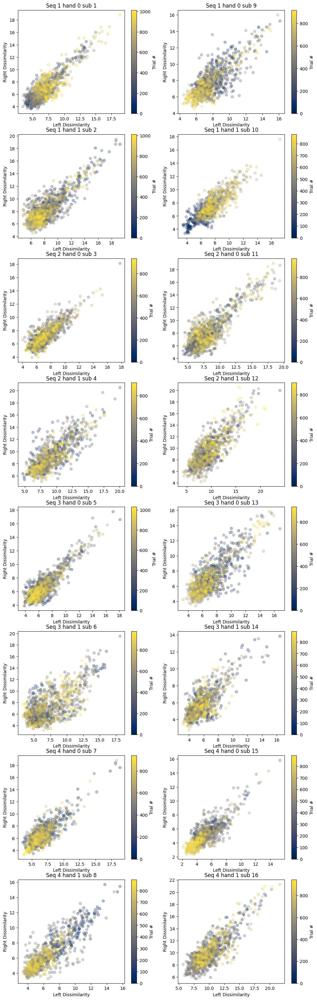

In [175]:

fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))
# smoothed_corrs = np.zeros(all_corrs_corr.shape[:-1])
smoothing_window = 20
window = np.ones((smoothing_window,))
window = window / window.sum()
# window[smoothing_window // 2] = 0
# window = window / window.sum()


for idx, ((seqnum, hand, subnum), distances) in enumerate(distances_dict.items()):
    smoothed_distances_left = {}
    smoothed_distances_right = {}
    for trial_idx, (index, row) in enumerate(distances.iterrows()):
        if trial_idx >= smoothing_window:
            smoothed_distances_left[index] = np.mean(row.iloc[trial_idx - smoothing_window: trial_idx])
        if trial_idx < len(distances) - smoothing_window:
            smoothed_distances_right[index] = np.mean(row.iloc[trial_idx + 1: trial_idx + smoothing_window + 1])


    ax_ind = (idx // 2, idx % 2)
    left_distances_keys = list(smoothed_distances_left.keys())
    right_distances_keys = list(smoothed_distances_right.keys())
    overlap_keys = set(left_distances_keys) & set(right_distances_keys)

    cmap = plt.get_cmap('cividis')
    norm = plt.Normalize(0, len(overlap_keys))
    
    for keyidx, key in enumerate(overlap_keys):
        color = cmap(norm(keyidx))
        # c = keyidx / len(overlap_keys)  # calculate the color gradient
        # axs[ax_ind].scatter(smoothed_distances_left[key], smoothed_distances_right[key], c=c, cmap='viridis')
        axs[ax_ind].scatter(smoothed_distances_left[key], smoothed_distances_right[key], color = color, alpha = 0.3)
    axs[ax_ind].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    axs[ax_ind].set_xlabel('Left Dissimilarity')
    axs[ax_ind].set_ylabel('Right Dissimilarity')

        
    # axs[ax_ind].legend()

    sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
    sm.set_array([])
    fig.colorbar(sm, ax=axs[ax_ind], label = 'Trial #')


# for seq in range(4):
#     for hand in range(2):
#         for subnum in range(total_sub_num//(4*2)):
#             for trial in range(num_trials):
#                 smoothed_corrs[seq, hand, subnum, trial] = np.convolve(all_corrs_corr[seq, hand, subnum, trial], window, mode='same')[trial]
#             subplot_idx = (seq *2 + hand, subnum)
#             axs[subplot_idx].scatter(all_error_trials[seq, hand, subnum], smoothed_corrs[seq, hand, subnum][all_error_trials[seq, hand, subnum]], color = 'red')
#             axs[subplot_idx].plot(smoothed_corrs[seq, hand, subnum])
#             axs[subplot_idx].set_ylim([0,1])

#             axs[subplot_idx].set_title(f'Seq {seq} hand {hand} Sub {subnum}')

                


In [184]:
n = 20
filter = np.zeros((2 * n, 2 * n))

filter[:n, :n] = -1
filter[n:, n:] = -1

filter[:n, n:] = 1
filter[n:, :n] = 1
filter

array([[-1., -1., -1., ...,  1.,  1.,  1.],
       [-1., -1., -1., ...,  1.,  1.,  1.],
       [-1., -1., -1., ...,  1.,  1.,  1.],
       ...,
       [ 1.,  1.,  1., ..., -1., -1., -1.],
       [ 1.,  1.,  1., ..., -1., -1., -1.],
       [ 1.,  1.,  1., ..., -1., -1., -1.]])

<Axes: >

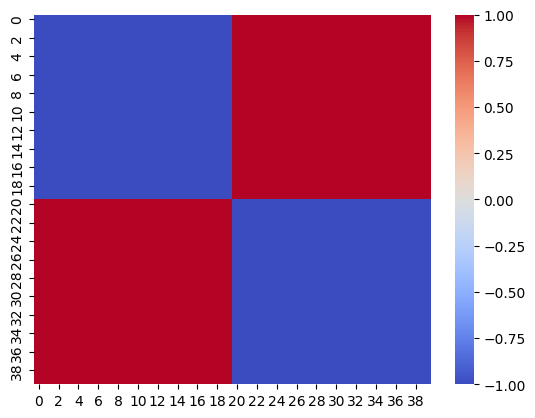

In [190]:
sns.heatmap(filter, cmap = 'coolwarm')

In [193]:
from scipy import signal
correlation = signal.correlate2d(distances, filter, mode='valid')
# Normalize the correlation between 0 and 1
correlation_min = correlation.min()
correlation_max = correlation.max()

normalized_correlation = (correlation - correlation_min) / (correlation_max - correlation_min)
normalized_correlation

array([[0.55316738, 0.53685205, 0.52742927, ..., 0.44154256, 0.43589756,
        0.44798557],
       [0.53685205, 0.5360013 , 0.5276522 , ..., 0.4451392 , 0.44149692,
        0.45111452],
       [0.52742927, 0.5276522 , 0.53321266, ..., 0.44675934, 0.44324433,
        0.4538896 ],
       ...,
       [0.44154256, 0.4451392 , 0.44675934, ..., 0.63879696, 0.64040219,
        0.65264414],
       [0.43589756, 0.44149692, 0.44324433, ..., 0.64040219, 0.65536659,
        0.66638666],
       [0.44798557, 0.45111452, 0.4538896 , ..., 0.65264414, 0.66638666,
        0.71404451]])

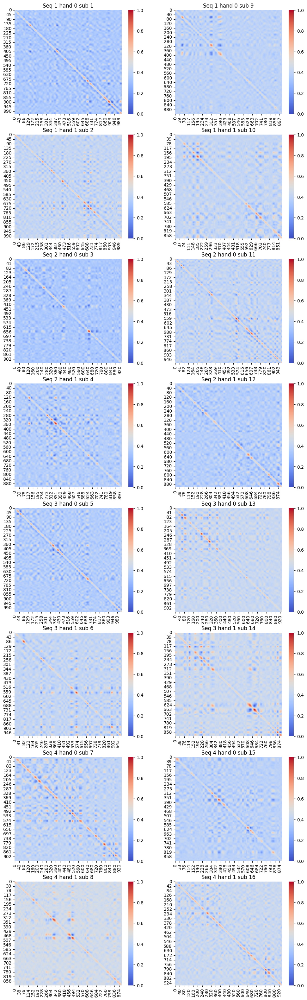

In [192]:
from scipy import signal

fig , axs = plt.subplots(4 * 2, 2, figsize = (12, 40))
for idx, ((seqnum, hand, subnum), distances) in enumerate(distances_dict.items()):
    error_trials = all_error_trials[(seqnum, hand, subnum)]
    # sns.heatmap(distances, cmap = 'coolwarm', ax=axs[idx //2 , idx % 2])
    # signal.correlate2d(distances, filter, mode='valid')
    correlation = signal.correlate2d(distances, filter, mode='valid')
    # Normalize the correlation between 0 and 1
    correlation_min = correlation.min()
    correlation_max = correlation.max()

    normalized_correlation = (correlation - correlation_min) / (correlation_max - correlation_min)
    sns.heatmap(normalized_correlation, cmap = 'coolwarm', ax=axs[idx //2 , idx % 2])
    # for trial in error_trials:
    #     axs[idx//2, idx % 2].annotate('', xy = (0, trial), xytext = (-1, trial), arrowprops = dict(facecolor = 'green', shrink = 0.05, headwidth = 0.1))
    axs[idx//2, idx % 2].set_title(f'Seq {seqnum} hand {hand} sub {subnum}')
    # plt.show()

In [177]:
distances_dict[(1,1,10)]

,4,5,6,7,8,9,10,11,13,14,...,1188,1189,1190,1192,1193,1195,1196,1197,1198,1200
4,0.000000,5.018911,4.717262,5.211909,6.500458,4.483090,5.715610,6.492856,5.625120,4.719147,...,9.601514,9.232953,9.955655,9.562421,11.087044,8.717221,7.836140,14.889997,11.541766,9.643563
5,5.018911,0.000000,2.046516,2.013118,4.980374,2.389888,2.723324,3.975993,4.834263,1.951440,...,8.760536,7.377384,8.196682,7.695681,9.130547,7.814984,6.433639,13.182480,9.707132,9.205180
6,4.717262,2.046516,0.000000,2.246671,5.471102,2.885447,3.550907,4.536939,4.845427,1.990144,...,8.926058,7.890965,8.674042,8.069876,9.647534,7.872361,6.447564,13.642217,10.239788,9.291395
7,5.211909,2.013118,2.246671,0.000000,5.216030,2.937127,2.443563,3.722748,5.277552,2.493877,...,8.864287,7.416932,8.158869,7.477899,9.020035,7.938768,6.076154,13.246456,9.739300,9.301101
8,6.500458,4.980374,5.471102,5.216030,0.000000,4.599049,4.621247,4.363576,5.645899,4.673129,...,7.369341,8.134769,8.502301,8.590609,9.650344,7.085510,5.952743,12.768418,9.559836,7.943910
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1195,8.717221,7.814984,7.872361,7.938768,7.085510,7.589594,7.591762,7.565623,7.748719,7.336231,...,9.075537,10.305487,10.626788,10.788980,11.735594,0.000000,8.080521,14.457350,11.115194,8.772829
1196,7.836140,6.433639,6.447564,6.076154,5.952743,6.514346,6.114513,5.839101,6.745201,6.387740,...,9.308337,9.101737,9.494297,9.063022,10.486682,8.080521,0.000000,13.843635,10.167672,9.720205
1197,14.889997,13.182480,13.642217,13.246456,12.768418,12.719687,12.587016,13.318211,14.188949,13.243101,...,11.682980,8.427711,7.959066,8.761904,7.326038,14.457350,13.843635,0.000000,6.062252,10.911223
1198,11.541766,9.707132,10.239788,9.739300,9.559836,9.101334,9.021324,10.037677,10.708703,9.728563,...,8.511660,5.257536,4.678780,6.325765,5.328024,11.115194,10.167672,6.062252,0.000000,8.835988


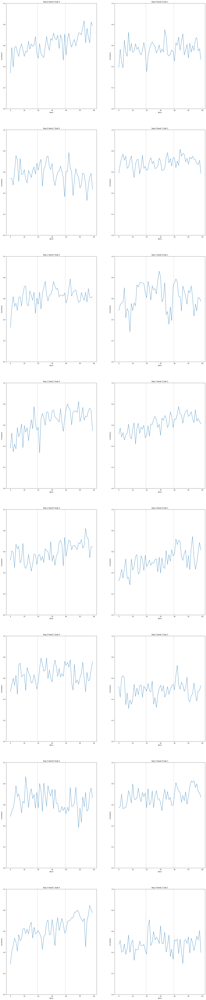

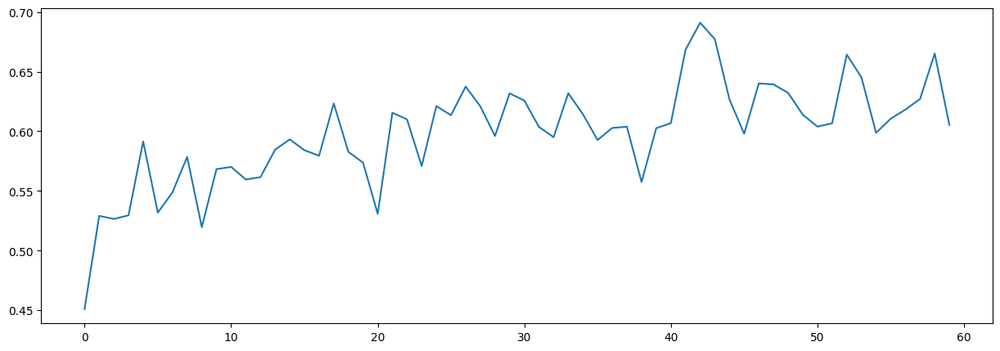

In [ ]:

fig , axs = plt.subplots(4 * 2, 2, figsize = (25, 125))
smoothed_corrs = np.zeros(all_corrs_corr.shape[:-1])
smoothing_window = 5
window = np.ones((smoothing_window,))
window[smoothing_window // 2] = 0
window = window / window.sum()
numblocks = len(subjs['BN'].unique())
smoothed_corrs_BN_agged = np.zeros((4, 2, total_sub_num//(4*2), numblocks))

for seq in range(4):
    for hand in range(2):
        for subnum in range(total_sub_num//(4*2)):
            for trial in range(num_trials):
                smoothed_corrs[seq, hand, subnum, trial] = np.convolve(all_corrs_corr[seq, hand, subnum, trial], window, mode='same')[trial]
            
            smoothed_corrs[seq,hand, subnum][all_error_trials[seq,hand, subnum]] = np.nan




for seq_idx, (seq, seq_data) in enumerate(subjs.groupby('seqType')):
    for hand, hand_data in seq_data.groupby('board'):
        for subidx, (subnum, subdata) in enumerate(hand_data.groupby('SubNum')):
            for blockidx, (block, blockdata) in enumerate(subdata.groupby('BN')):
                block_ranks = blockdata['Rank'].unique().astype('int') - 1
                smoothed_corrs_BN_agged[seq_idx, hand, subidx, blockidx] = np.nanmean(smoothed_corrs[seq_idx, hand, subidx, block_ranks])
            
            subplot_idx = (seq_idx * 2 + hand, subidx)
            axs[subplot_idx].plot(smoothed_corrs_BN_agged[seq_idx, hand, subidx])
            axs[subplot_idx].set_ylim([0,1])
            axs[subplot_idx].set_title(f'Seq {seq_idx} hand {hand} Sub {subidx}')
            axs[subplot_idx].set_xlabel('Block')
            axs[subplot_idx].set_ylabel('Correlation')
            axs[subplot_idx].axvline(19.5, color = 'gray', linestyle = 'dotted')
            axs[subplot_idx].axvline(39.5, color = 'gray', linestyle = 'dotted')


plt.figure(figsize=(15, 5))
plt.plot(smoothed_corrs_BN_agged.mean(axis = (0,1,2)))



# for seq in range(4):
#     for hand in range(2):
#         for subnum in range(total_sub_num//(4*2)):
#             for trial in range(num_trials):
#                 smoothed_corrs[seq, hand, subnum, trial] = np.convolve(all_corrs_corr[seq, hand, subnum, trial], window, mode='same')[trial]
#             subplot_idx = (seq *2 + hand, subnum)
#             axs[subplot_idx].scatter(all_error_trials[seq, hand, subnum], smoothed_corrs[seq, hand, subnum][all_error_trials[seq, hand, subnum]], color = 'red')
#             axs[subplot_idx].plot(smoothed_corrs[seq, hand, subnum])
#             axs[subplot_idx].set_ylim([0,1])

#             axs[subplot_idx].set_title(f'Seq {seq} hand {hand} Sub {subnum}')

                


In [ ]:

fig , axs = plt.subplots(4 * 2, 2, figsize = (25, 125))
smoothed_corrs = np.zeros(all_corrs_corr.shape[:-1])
smoothing_window = 5
window = np.ones((smoothing_window,))
window[smoothing_window // 2] = 0
window = window / window.sum()

for seq in range(4):
    for hand in range(2):
        for subnum in range(total_sub_num//(4*2)):
            for trial in range(num_trials):
                smoothed_corrs[seq, hand, subnum, trial] = np.convolve(all_corrs_corr[seq, hand, subnum, trial], window, mode='same')[trial]
            subplot_idx = (seq *2 + hand, subnum)
            axs[subplot_idx].scatter(all_error_trials[seq, hand, subnum], smoothed_corrs[seq, hand, subnum][all_error_trials[seq, hand, subnum]], color = 'red')
            axs[subplot_idx].plot(smoothed_corrs[seq, hand, subnum])
            axs[subplot_idx].set_ylim([0,1])

            axs[subplot_idx].set_title(f'Seq {seq} hand {hand} Sub {subnum}')

                
